In [2]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec, GridSpecFromSubplotSpec
from numpy.linalg import svd
import networkx as nx

import importlib

import dgsp
import graph_examples as dgsp_graphs
import plotting as dgsp_plot

In [3]:
from matplotlib.colors import to_rgb
# Red, Blue, Green, Purple
colorpalette = ["#FFADAD", "#A0C4FF", "#CAFFBF", "#FFC6FF"]
palette_rgb = [to_rgb(color) for color in colorpalette]

# Loading neuron data

In [4]:
path_to_adj = "data/SI 5 Connectome adjacency matrices, corrected July 2020.xlsx"
neuron_adj_df = pd.ExcelFile(path_to_adj)
print("Sheet names are:", neuron_adj_df.sheet_names)

chem_df = neuron_adj_df.parse("hermaphrodite chemical")

# Getting neuron informations
# Dropping Nans
neuron_def_df = chem_df.iloc[:, :3].dropna(how="all").ffill()
neuron_def_df.columns = ["Type", "Detail", "Neuron"]
# Dropping Pharynx neurons
neuron_def_df = neuron_def_df[neuron_def_df.Type != "PHARYNX"].reset_index(drop=True)

lab_to_id = {lab: i for i, lab in enumerate(neuron_def_df["Neuron"].values)}

# Adding landmark information (average position on antero-posterior axis)
path_to_neurons_types = "data/NeuronFixedPoints.xls"
neuron_AvgLandmarkPos = pd.read_excel(path_to_neurons_types).groupby("Neuron")["Landmark Position"].mean()

neuron_def_df = neuron_def_df.merge(neuron_AvgLandmarkPos, on="Neuron", how="left")

# Order Neurons by Type and Landmark Position
#neuron_def_df = neuron_def_df.sort_values(["Type", "Landmark Position"])

type_to_num = {t: i for i, t in enumerate(neuron_def_df["Type"].unique())}
neuron_def_df["Type_num"] = [type_to_num[t] for t in neuron_def_df["Type"]]

all_labels = neuron_def_df["Neuron"].values.tolist()
print(f"There are {len(all_labels)} neurons in the dataset")

fixed_details = [lab.replace(" MOTOR NEURONS", "") if "MOTOR NEURONS" in str(lab) else lab for lab in neuron_def_df.loc[:, "Detail"]]
neuron_def_df.loc[:, "Detail"] = fixed_details

neuron_def_df["Type_long"] = neuron_def_df["Type"]+"_"+neuron_def_df["Detail"].astype(str)

type_long_to_num = {t: i for i, t in enumerate(neuron_def_df["Type_long"].unique())}
neuron_def_df["TypeLong_num"] = [type_long_to_num[t] for t in neuron_def_df["Type_long"]]

neuron_def_df

Sheet names are: ['TITLE AND LEGEND', 'hermaphrodite chemical', 'hermaphrodite gap jn asymmetric', 'hermaphrodite gap jn symmetric', 'male chemical', 'male gap jn asymmetric', 'male gap jn symmetric']
There are 280 neurons in the dataset


,Type,Detail,Neuron,Landmark Position,Type_num,Type_long,TypeLong_num
0,SENSORY NEURONS,6,ASIL,0.00,0,SENSORY NEURONS_6,0
1,SENSORY NEURONS,6,ASIR,0.00,0,SENSORY NEURONS_6,0
2,SENSORY NEURONS,6,ASJL,0.00,0,SENSORY NEURONS_6,0
3,SENSORY NEURONS,6,ASJR,0.00,0,SENSORY NEURONS_6,0
4,SENSORY NEURONS,6,AWAL,0.01,0,SENSORY NEURONS_6,0
...,...,...,...,...,...,...,...
275,SEX SPECIFIC,VENTRAL CORD,VC02,0.54,3,SEX SPECIFIC_VENTRAL CORD,13
276,SEX SPECIFIC,VENTRAL CORD,VC03,0.54,3,SEX SPECIFIC_VENTRAL CORD,13
277,SEX SPECIFIC,VENTRAL CORD,VC04,0.54,3,SEX SPECIFIC_VENTRAL CORD,13
278,SEX SPECIFIC,VENTRAL CORD,VC05,0.54,3,SEX SPECIFIC_VENTRAL CORD,13


# Manually building the wiring network

In [230]:
path_to_neurons_file = "data/NeuronConnect.xls"
celegans_df = pd.read_excel(path_to_neurons_file)

# Create a graph for each connection type
all_neurons = np.unique(np.hstack([celegans_df["Neuron 1"].unique(), celegans_df["Neuron 2"].unique()]))
neuron_to_id = {neuron: i for i, neuron in enumerate(all_neurons)}
n_neurons = len(all_neurons)

# Discard NMJ connections
conn_types = [conn for conn in celegans_df["Type"].unique() if conn != "NMJ"]
n_mod = len(conn_types)

raw_adj = np.zeros((n_mod, n_neurons, n_neurons))

for i, connection_type in enumerate(conn_types):
    print(connection_type)
    reduced_df = celegans_df[celegans_df["Type"] == connection_type]
    #adj_df = reduced_df.pivot(index="Neuron 1", columns="Neuron 2", values="Nbr").fillna(0)
    #label_from = adj_df.index.to_list()
    #label_to = adj_df.columns.to_list()
    #print(label_from)
    #print(label_to)
    #mask_from = [lab in label_from for lab in all_neurons]
    #mask_to = [lab in label_to for lab in all_neurons]
    #np.putmask(raw_adj[i], np.outer(mask_from, mask_to), adj_df.values)

    i_s = [neuron_to_id[lab] for lab in reduced_df.loc[:, "Neuron 1"]]
    j_s = [neuron_to_id[lab] for lab in reduced_df.loc[:, "Neuron 2"]]

    raw_adj[i][i_s, j_s] = reduced_df.loc[:, "Nbr"].values

    print(raw_adj[i].sum())
    print(raw_adj[i].shape)

EJ
1777.0
(283, 283)
Sp
3964.0
(283, 283)
R
1427.0
(283, 283)
Rp
4967.0
(283, 283)
S
2430.0
(283, 283)


In [256]:
print(conn_types)

send_receive = np.logical_and((raw_adj[4] > 0), (raw_adj[2].T > 0))
send_receive_multi = np.logical_and((raw_adj[1] > 0), (raw_adj[3].T > 0))

custom_chem = ((send_receive_multi + send_receive) > 0).astype(int)
custom_gap = np.logical_and((raw_adj[0] > 0), (raw_adj[0].T > 0))

print(np.sum(send_receive))
print(np.sum(send_receive_multi))
print(np.sum(manual_gap))

['EJ', 'Sp', 'R', 'Rp', 'S']
773
1622
1031


# Old graphs

In [154]:
neuron_AvgLandmarkPos = pd.read_excel(path_to_neurons_types)#.groupby("Neuron")["Landmark Position"].mean()

#neuron_def_df = neuron_def_df.merge(neuron_AvgLandmarkPos, on="Neuron", how="left")


In [155]:
chem_df_check = neuron_adj_df.parse("hermaphrodite chemical", header=None)

# Send
send_df = chem_df_check.iloc[:, :3].dropna(how="all").ffill()
send_df.columns = ["Type", "Detail", "Neuron"]
# Dropping Pharynx neurons
send_df = send_df[send_df.Type != "PHARYNX"].reset_index(drop=True)

# Receive
receive_df = chem_df_check.T.iloc[:, :3].dropna(how="all").ffill()
receive_df.columns = ["Type", "Detail", "Neuron"]
# Dropping Pharynx neurons

useless_types = ["PHARYNX", "OTHER END ORGANS", "BODYWALL MUSCLES"]

mask = np.ones_like(receive_df.Type, dtype=bool)

for t in useless_types:
    mask = mask & (receive_df.Type != t).to_list()

mask = mask & (["vm" not in lab for lab in receive_df.Neuron])

receive_df = receive_df.loc[mask].reset_index(drop=True)

intersection = np.intersect1d(send_df.Neuron, all_neurons)
print(len(intersection))

[lab for lab in all_neurons if lab not in intersection]


280


['NMJ', 'avfl', 'avfr']

In [156]:
# Cleaning the chemical data into an adjacency matrix
col_labels = chem_df.loc[1].values
row_labels = chem_df.loc[:, "Unnamed: 2"].values

col_ids = np.array([lab_to_id[lab] if lab in all_labels else None for lab in col_labels])
row_ids = np.array([lab_to_id[lab] if lab in all_labels else None for lab in row_labels])

col_mask = [lab is not None for lab in col_ids]
row_mask = [lab is not None for lab in row_ids]

# Masking dataframe
chem_adj_clean = chem_df.loc[row_mask, col_mask].reset_index(drop=True).copy().fillna(0).values
# Re-ordering the adjacency matrix
chem_adj_clean = chem_adj_clean[row_ids[row_mask].astype(int)][:, col_ids[col_mask].astype(int)]

print(chem_adj_clean.shape)

(280, 280)


/var/folders/nj/ltrlv15x5jj2jq78pbb2srz80000gn/T/ipykernel_96079/4027334819.py:12: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



In [157]:
# Cleaning the electrical data into an adjacency matrix
gap_df = neuron_adj_df.parse("hermaphrodite gap jn symmetric")

col_labels = gap_df.loc[1].values
row_labels = gap_df.loc[:, "Unnamed: 2"].values

col_ids = np.array([lab_to_id[lab] if lab in all_labels else None for lab in col_labels])
row_ids = np.array([lab_to_id[lab] if lab in all_labels else None for lab in row_labels])

col_mask = [lab is not None for lab in col_ids]
row_mask = [lab is not None for lab in row_ids]

# Masking dataframe
gap_adj_clean = gap_df.loc[row_mask, col_mask].reset_index(drop=True).fillna(0).values
# Re-ordering the adjacency matrix
gap_adj_clean = gap_adj_clean[row_ids[row_mask].astype(int)][:, col_ids[col_mask].astype(int)]
print(gap_adj_clean.shape)

(280, 280)


/var/folders/nj/ltrlv15x5jj2jq78pbb2srz80000gn/T/ipykernel_96079/822817989.py:14: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



Symmetric wiring matrix has shape (283, 283)


Text(0.5, 1.0, 'Eigenvectors (2 smallest non zero)')

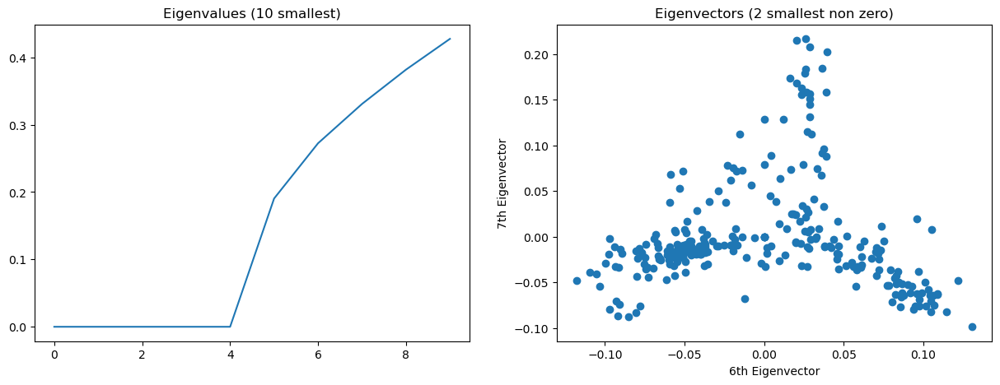

In [257]:
from numpy.linalg import eig, pinv

#wiring_adj = raw_adj[0] + raw_adj[1] + raw_adj[4]
wiring_adj = ((gap_adj_clean + chem_adj_clean) > 0).astype(int)
wiring_adj = ((manual_chem + manual_gap) > 0).astype(int)
wiring_adj = wiring_adj - np.diag(np.diag(wiring_adj))

n_neurons = len(wiring_adj)

has_zero_deg = np.intersect1d(np.where(wiring_adj.sum(axis=1) == 0)[0], np.where(wiring_adj.sum(axis=0) == 0)[0])
non_zero_deg_mask = np.array([i not in has_zero_deg for i in range(n_neurons)])

#wiring_adj_chen = wiring_adj[non_zero_deg_mask][:, non_zero_deg_mask]
wiring_adj_chen = wiring_adj
wiring_sym_chen = (wiring_adj_chen + wiring_adj_chen.T > 0).astype(int)


print(f"Symmetric wiring matrix has shape {wiring_sym_chen.shape}")

d_mat = np.diag(wiring_sym_chen.sum(axis=1))
L = d_mat - wiring_sym_chen

L_norm = np.sqrt(pinv(d_mat)) @ L @ np.sqrt(pinv(d_mat))

eig_val, eig_vect = eig(L_norm)

sort_idx = np.argsort(eig_val)
eig_val = eig_val[sort_idx]
eig_vect = eig_vect[:, sort_idx]

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))

show_n_eig = 10
axes[0].plot(eig_val.real[:show_n_eig])
axes[0].set_title(f"Eigenvalues ({show_n_eig} smallest)")

eig_id = np.where(eig_val.real > 0)[0][0]

axes[1].scatter(eig_vect[:, eig_id].real, eig_vect[:, eig_id+1].real)
axes[1].set_xlabel(f"{eig_id + 1}th Eigenvector")
axes[1].set_ylabel(f"{eig_id + 2}th Eigenvector")
axes[1].set_title("Eigenvectors (2 smallest non zero)")

Text(0.5, 1.0, 'Eigenvectors (2 smallest non zero)')

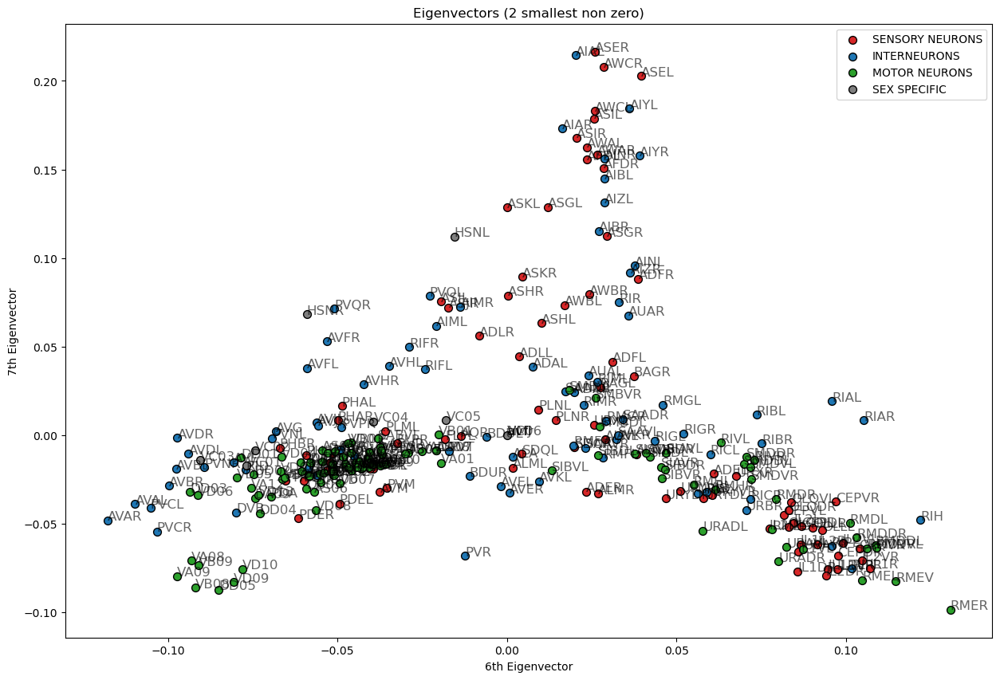

In [262]:
fig, axes = plt.subplots(figsize=(15, 10))

eig_id = np.where(eig_val.real > 0)[0][0]

#mycmap = plt.get_cmap("tab10")
colors = ["tab:red", "tab:blue", "tab:green", "tab:gray"]

#for i, n_type in enumerate(neuron_def_df["Type"].unique()):
#    type_mask = neuron_def_df["Type"] == n_type
#    axes.scatter(eig_vect[type_mask, eig_id].real, eig_vect[type_mask, eig_id+1].real, color=colors[i], s=50, label=n_type)

nodes_labels = all_neurons

for i, n_type in enumerate(neuron_def_df["Type"].unique()):
    neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]

    type_mask = np.array([lab in neurons_in_type.values for lab in nodes_labels])
    axes.scatter(eig_vect[type_mask, eig_id].real, eig_vect[type_mask, eig_id+1].real, color=colors[i], s=50, label=n_type,
                 zorder=3, edgecolor="k", lw=1, alpha=1)

#for i, neuron in neuron_def_df.iterrows():
for i, neuron in enumerate(nodes_labels):

    color=0.6

    axes.text(eig_vect[i, eig_id].real, eig_vect[i, eig_id+1].real, neuron, fontsize=12, alpha=color)

axes.legend()
axes.set_xlabel(f"{eig_id + 1}th Eigenvector")
axes.set_ylabel(f"{eig_id + 2}th Eigenvector")
axes.set_title("Eigenvectors (2 smallest non zero)")

Text(0.5, 0.92, 'Eigenvectors (2 smallest non zero)')

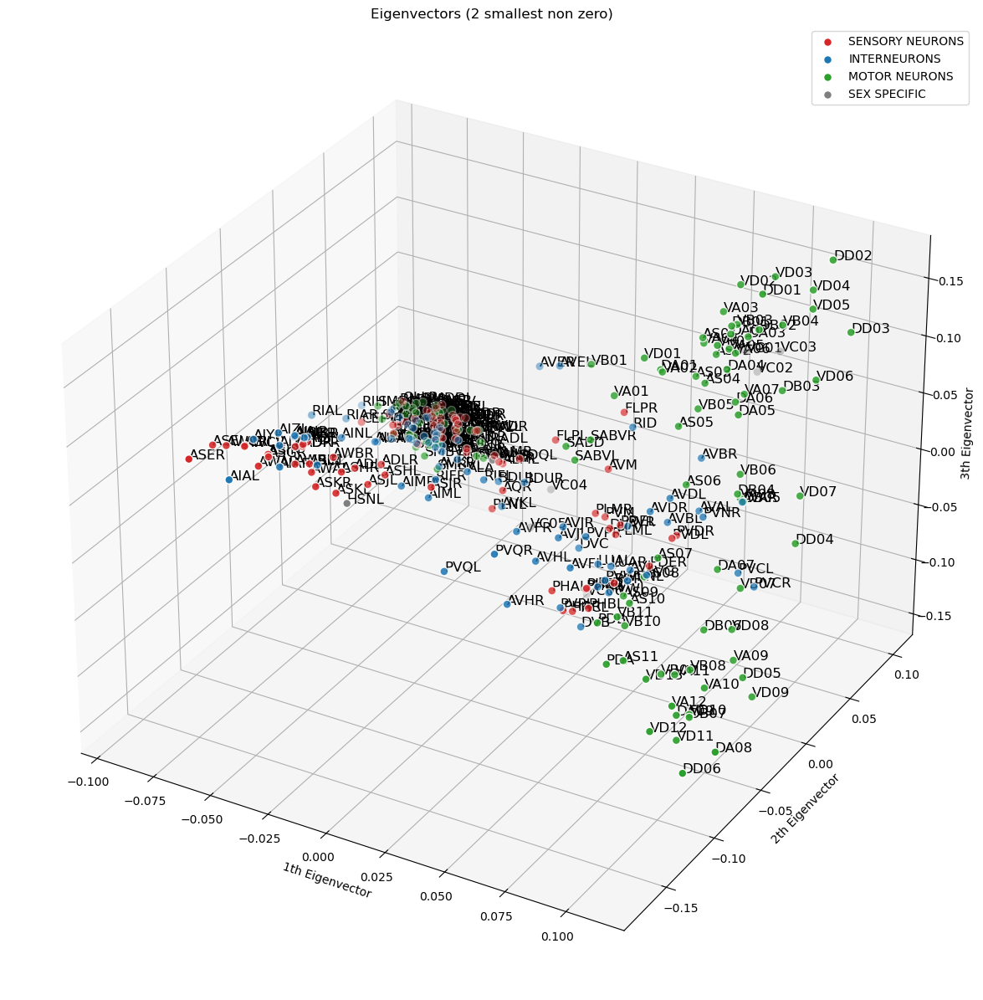

In [162]:
fig, axes = plt.subplots(figsize=(15, 15), subplot_kw={"projection":"3d"})

eig_id = np.where(eig_val.real > 0)[0][0]

#mycmap = plt.get_cmap("tab10")
colors = ["tab:red", "tab:blue", "tab:green", "tab:gray"]

for i, n_type in enumerate(neuron_def_df["Type"].unique()):
    type_mask = neuron_def_df["Type"] == n_type
    axes.scatter(eig_vect[type_mask, eig_id].real, eig_vect[type_mask, eig_id+1].real, eig_vect[type_mask, eig_id+2].real, color=colors[i],
                 s=50, label=n_type, edgecolor="w", zorder=1)

for i, neuron in neuron_def_df.iterrows():
    axes.text(eig_vect[i, eig_id].real, eig_vect[i, eig_id+1].real, eig_vect[i, eig_id+2].real, neuron["Neuron"], fontsize=12, zorder=0)

axes.legend()
axes.set_xlabel(f"{eig_id}th Eigenvector")
axes.set_ylabel(f"{eig_id+1}th Eigenvector")
axes.set_zlabel(f"{eig_id+2}th Eigenvector")
axes.set_title("Eigenvectors (2 smallest non zero)")

In [163]:
import plotly.express as px

df = pd.DataFrame(eig_vect[:, 1:4].real, columns=[f"eig {i+1}" for i in range(3)])
df["Type"] = neuron_def_df["Type"]
df["Neuron"] = neuron_def_df["Neuron"]
df["Size"] = 100

range_val = .2

fig = px.scatter_3d(df, x="eig 1", y="eig 2", z="eig 3", color="Type", text="Neuron", size="Size",
                    range_x=[-range_val, range_val], range_y=[-range_val, range_val], range_z=[-range_val, range_val],
                    height=1200, width=1500)
fig.show()


# Bullmore's data

In [5]:
path_to_bullmore = "data/celegans-bullmore"
bullmore_file = "Worm279dir.mat"

from scipy.io import loadmat
import os.path as op

bullmore_dict = loadmat(op.join(path_to_bullmore, bullmore_file))

print(bullmore_dict.keys())

bullmore_adj_sum = bullmore_dict["Worm279_matrix_dir"]
bullmore_adj_gap = bullmore_dict["Worm279_ejunct_matrix_dir"]
bullmore_adj_chem = bullmore_dict["Worm279_synapse_matrix_dir"]

bullmore_label = np.array([lab[0][0] for lab in bullmore_dict["Worm279_labels"]])
bullmore_type = [neuron_def_df[neuron_def_df["Neuron"] == lab]["Type"].values[0] for lab in bullmore_label]
bullmore_type_num = [neuron_def_df[neuron_def_df["Neuron"] == lab]["Type_num"].values[0] for lab in bullmore_label]
bullmore_landmark = [neuron_def_df[neuron_def_df["Neuron"] == lab]["Landmark Position"].values[0] for lab in bullmore_label]

bullmore_pos = bullmore_dict["Worm279_positions"]

no_sex = False
# REMOVE SEX SPECIFIC NEURONS
if no_sex:
    no_sex_spec = np.array(bullmore_type_num, dtype=int) < 3
    bullmore_type = np.array(bullmore_type)[no_sex_spec]
    bullmore_type_num = np.array(bullmore_type_num)[no_sex_spec]
    bullmore_label = np.array(bullmore_label)[no_sex_spec]
    bullmore_pos = np.array(bullmore_pos)[no_sex_spec]
    bullmore_adj_gap = np.array(bullmore_adj_gap)[no_sex_spec][:, no_sex_spec]
    bullmore_adj_chem = np.array(bullmore_adj_chem)[no_sex_spec][:, no_sex_spec]

bullmore_to_label = [lab_to_id[lab] for lab in bullmore_label]
label_to_bullmore = np.argsort(bullmore_to_label)

gap_adj_bull = bullmore_adj_gap[bullmore_to_label][:, bullmore_to_label]
chem_adj_bull = bullmore_adj_chem[bullmore_to_label][:, bullmore_to_label]

chen_adj = bullmore_dict["Worm279_matrix"]
whole_adj_chen = chen_adj[bullmore_to_label][:, bullmore_to_label]

bullmore_label_cleaned = bullmore_label[label_to_bullmore]

dict_keys(['__header__', '__version__', '__globals__', 'Worm279_birthtime', 'Worm279_labels', 'Worm279_positions', 'Worm279_elist_connectiontype', 'Worm279_elist_connectionstrength', 'Worm279_Wmatrix', 'Worm279_matrix', 'Worm279_synapse_matrix_dir', 'Worm279_ejunct_matrix_dir', 'Worm279_matrix_dir'])


# Comparing all networks

In [5]:
STR_NEURON_TYPES=[['ADE','ADF','ADL','AFD','ALM','ALN','AQR','ASE','ASG','ASH','ASI','ASJ','ASK','PVM','PH','AW','AF','OLL','BAG','PLM','CEP','FL','PQR','AVM','URY','HOA','HOB','PDE','PVD','SPV'], # sensory
                  ['ADA','AI','AVG','AUA','DVA','DBV','DVC','DVE','DVF','LUA','AVF','PGA','PVT','PVU','PVQ','PVW','PVP','BD','RIC','RIS','RIH','RIP','RIR','RIA','RIB','RIF','PVR','PVS','PVX','RIG','PVC','AVA','AVB','AVD','AVE','AVH','AVJ','AVK','RMG','URB','MCML','MCMR'], # inter
                  ['AS01','AS02','AS03','AS04','AS05','AS06','AS07','AS08','AS09','AS10','AS11','MCL','MCR','DA','VB','VA','HS','DD','VC','DB','VD','SM','RMD','RME','RMF','RMH','URA','PDA','PDB'], # motor
                  ['IL1','IL2'], # polymodal (S, I, M)
                  ['OLQ','PLN','SDQ','URX','ALA'], # polymodal (S, I)
                  ['AVL','DVB','MI','PDC','PVN','PVV','PVY','PVZ','RID','RIM','RIV','SAA','SAB','SIA','SIB','CA'], # polymodal (I, M)
                  ['PCA','PCB','PCC','SPC','SPD','NSM']] # polymodal (S, M)
    
NODE_TYPE_LABEL = ['sensory','inter','motor', 'sensory-inter-motor', 'sensory-inter', 'inter-motor', 'sensory-motor']

neuron_dict = {}
for neuron_name, neuron_types in zip(STR_NEURON_TYPES, NODE_TYPE_LABEL):
    neuron_dict.update({name: neuron_types for name in neuron_name})

dvdv_neuron_def = pd.DataFrame([neuron_dict.keys(), neuron_dict.values()], index=["Neuron", "Type"]).T
dvdv_neuron_def

,Neuron,Type
0,ADE,sensory
1,ADF,sensory
2,ADL,sensory
3,AFD,sensory
4,ALM,sensory
...,...,...
125,PCB,sensory-motor
126,PCC,sensory-motor
127,SPC,sensory-motor
128,SPD,sensory-motor


In [6]:
print(len(bullmore_label.tolist()))

print(len(neuron_def_df.Neuron.to_list()))

#id_to_bullmore = [np.where(bullmore_label == neur)[0][0] for neur in neuron_def_df.Neuron.to_list() if neur in bullmore_label]
id_to_bullmore = [np.where(neuron_def_df.Neuron.to_numpy() == neur)[0][0] for neur in bullmore_label if neur in neuron_def_df.Neuron.to_numpy()]

print(len(id_to_bullmore))

neuron_def_df

279
280
279


,Type,Detail,Neuron,Landmark Position,Type_num,Type_long,TypeLong_num
0,SENSORY NEURONS,6,ASIL,0.00,0,SENSORY NEURONS_6,0
1,SENSORY NEURONS,6,ASIR,0.00,0,SENSORY NEURONS_6,0
2,SENSORY NEURONS,6,ASJL,0.00,0,SENSORY NEURONS_6,0
3,SENSORY NEURONS,6,ASJR,0.00,0,SENSORY NEURONS_6,0
4,SENSORY NEURONS,6,AWAL,0.01,0,SENSORY NEURONS_6,0
...,...,...,...,...,...,...,...
275,SEX SPECIFIC,VENTRAL CORD,VC02,0.54,3,SEX SPECIFIC_VENTRAL CORD,13
276,SEX SPECIFIC,VENTRAL CORD,VC03,0.54,3,SEX SPECIFIC_VENTRAL CORD,13
277,SEX SPECIFIC,VENTRAL CORD,VC04,0.54,3,SEX SPECIFIC_VENTRAL CORD,13
278,SEX SPECIFIC,VENTRAL CORD,VC05,0.54,3,SEX SPECIFIC_VENTRAL CORD,13


In [7]:
print(conn_types)

sort_bullmore = [np.where(bullmore_label == lab)[0][0] for lab in neuron_def_df.Neuron.to_list() if lab in bullmore_label]

bull_chem_sorted = bullmore_adj_chem[sort_bullmore][:, sort_bullmore].copy()
bull_gap_sorted = bullmore_adj_gap[sort_bullmore][:, sort_bullmore].copy()

NameError: name 'conn_types' is not defined

NameError: name 'chem_adj_clean' is not defined

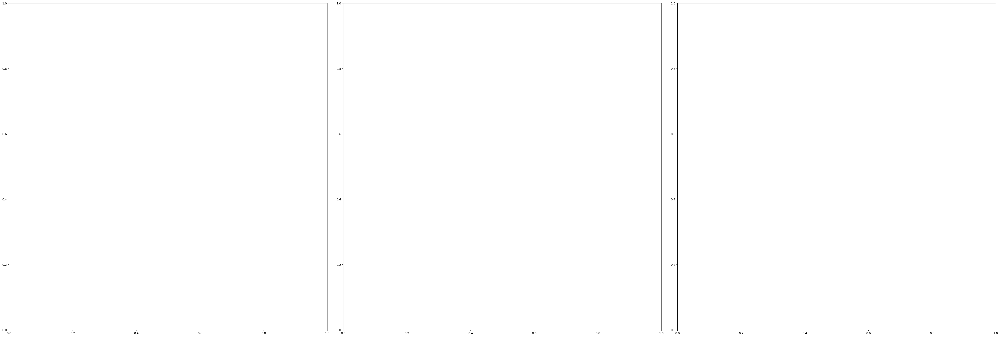

In [8]:
heigths = 20
fig, axes = plt.subplots(ncols=3, figsize=(3*heigths, heigths), gridspec_kw={"wspace":.05})
#fig, axes = plt.subplots(nrows=3, figsize=(heigths, heigths//3), gridspec_kw={"wspace":.05})

mask_regions = []
#mask_regions = ["AVAL", "AVAR", "PVCL", "PVCR"]

matrices_in_neuron_df = np.zeros((3, len(neuron_def_df), len(neuron_def_df)))
matrices_unweighted = np.zeros((3, len(neuron_def_df), len(neuron_def_df)))

for i, (chem, gap, title, labels) in enumerate(zip([chem_adj_clean, bullmore_adj_chem, custom_chem],
                                                   [gap_adj_clean, bullmore_adj_gap, custom_gap],
                                                   ["Chen", "Bullmore", "Custom"],
                                                   [np.array(all_labels), bullmore_label, all_neurons])):   

    # Plotting chemical synapse network
    sorting = [np.where(labels == lab)[0][0] for lab in neuron_def_df.Neuron.to_list() if lab in labels]
    mask = np.array([lab in neuron_def_df.Neuron.to_list() for lab in labels])

    n_neurons = len(labels[mask])

    thresh = 0
    if title != "Bullmore":
        thresh = 0
    
    y_idx, x_idx = np.where(chem[sorting][:, sorting] > thresh)
    x, y = np.array([(x, y) for x, y in zip(x_idx, y_idx)]).T

    matrices_in_neuron_df[i, x_idx, y_idx] = 1
    matrices_unweighted[i, x_idx, y_idx] = chem[sorting][:, sorting][y_idx, x_idx]

    axes[i].scatter(x, -y, s=10, color="tab:red", alpha=.8)
    #axes[i].scatter(x, -y, s=50, color="tab:red", alpha=.8)

    # Plotting chemical synapse network
    y_idx, x_idx = np.where(gap[sorting][:, sorting] > thresh)
    x, y = np.array([(x, y) for x, y in zip(x_idx, y_idx)]).T

    axes[i].scatter(x, -y, s=12, color="none", edgecolor="tab:blue")
    #axes[i].scatter(x, -y, s=55, color="none", edgecolor="tab:blue")

    # Cleaning the plot
    axes[i].set_title(title+f" (gap: sum: {(gap>0).sum()}, max: {gap.max()} - chem: sum: {(chem>0).sum()}, max: {chem.max()})")
    
    axes[i].set_xticks(np.arange(0, len(labels[mask]), 1))
    axes[i].set_yticks(-np.arange(0, len(labels[mask]), 1))
    
    axes[i].set_xticklabels(labels[mask], fontsize=6, rotation=90)
    axes[i].set_yticklabels(labels[mask], fontsize=6)

    #axes[i].grid()
    axes[i].axis([-0.5, n_neurons, -n_neurons, 0.5])

    #cumsum = 0
    #for n_type in neuron_def_df.Type.unique()[:-1]:
    #    cumsum += neuron_def_df.value_counts("Type")[n_type]
    #    axes[i].plot([0, n_neurons], [-cumsum]*2, color="black", alpha=.5)
    #    axes[i].plot([cumsum]*2, [0, -n_neurons], color="black", alpha=.5)

    #axes[i].axis([-1, 50, -1, 50])

#fig.savefig("./figures/chen_bullmore_custom.png", dpi=300)

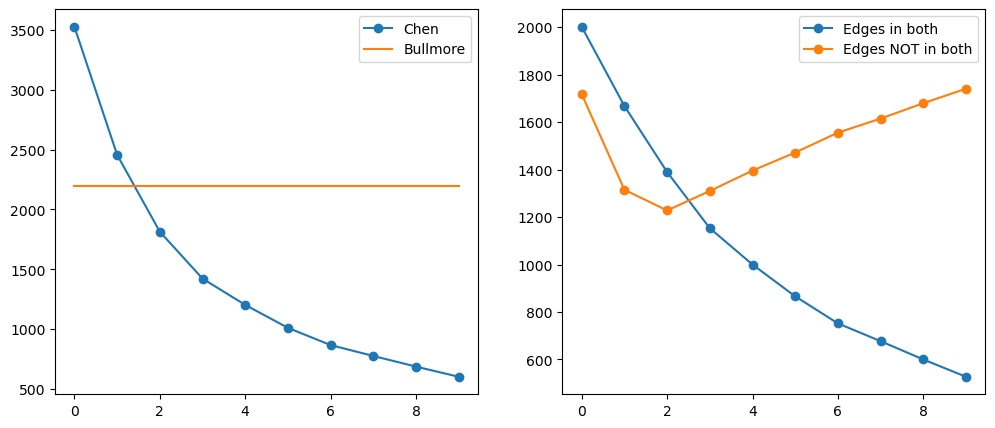

In [253]:
wiring_adj = matrices_unweighted[0]
wiring_adj -= np.diag(np.diag(wiring_adj))

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

threshes = np.arange(0, 10, 1)

n_edges = []
in_both = []
errors = []
for thresh in threshes:
    wiring_sym = (wiring_adj > thresh).astype(int)

    n_edges.append(wiring_sym.sum())

    in_both.append(np.logical_and(matrices_unweighted[0] > thresh, matrices_unweighted[1]).sum())
    errors.append(np.logical_xor(matrices_unweighted[0] > thresh, matrices_unweighted[1]).sum())

axes[0].plot(threshes, n_edges, "o-", color="tab:blue")
axes[0].plot(threshes, [bullmore_adj_chem.astype(int).sum()]*len(threshes), color="tab:orange")
axes[0].legend(["Chen", "Bullmore"])

axes[1].plot(threshes, in_both, "o-", color="tab:blue", label="Edges in both")
axes[1].plot(threshes, errors, "o-", color="tab:orange", label="Edges NOT in both")

axes[1].legend()

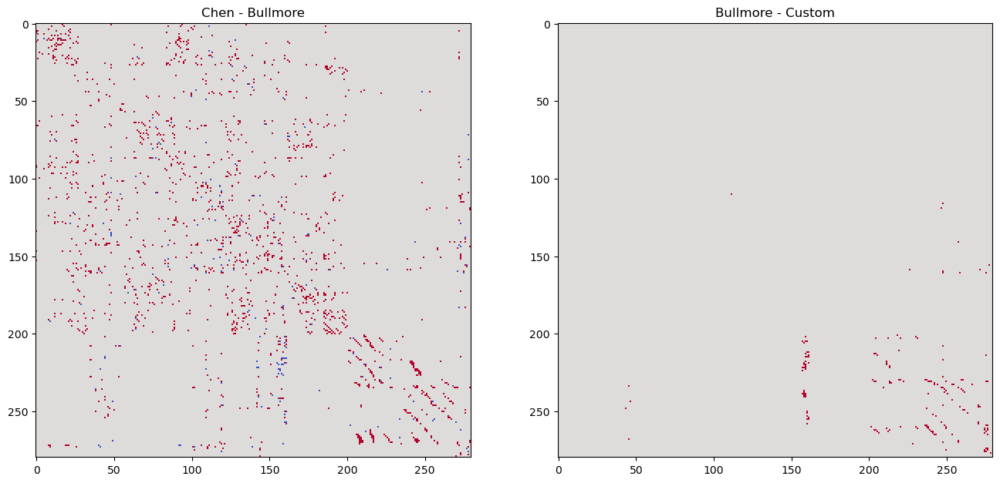

In [254]:
fig, axes = plt.subplots(ncols=2, figsize=(16, 8))

axes[0].set_title("Chen - Bullmore")
axes[0].imshow(matrices_in_neuron_df[0] - matrices_in_neuron_df[1], cmap="coolwarm", interpolation="none", vmin=-1, vmax=1)

axes[1].set_title("Bullmore - Custom")
axes[1].imshow(matrices_in_neuron_df[1] - matrices_in_neuron_df[2], cmap="coolwarm", interpolation="none", vmin=-1, vmax=1)

# Looking at the graph

{'INTERNEURONS': 0, 'MOTOR NEURONS': 1, 'SENSORY NEURONS': 2, 'SEX SPECIFIC': 3}


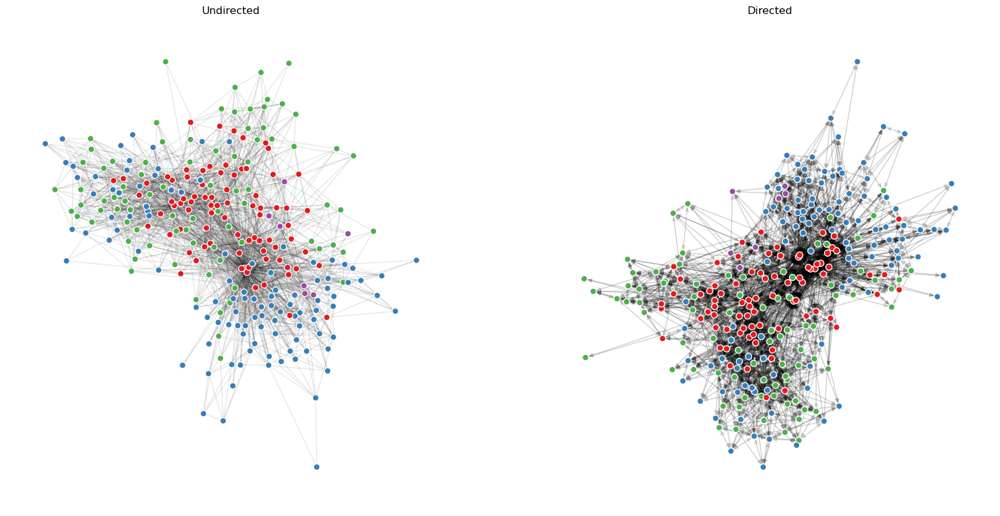

In [6]:
wiring_dir = (bullmore_adj_gap + bullmore_adj_chem > 0).astype(int)
wiring_undir = ((wiring_dir + wiring_dir.T) > 0).astype(int)

type_to_id = {t: i for i, t in enumerate(np.unique(bullmore_type))}
print(type_to_id)
cmap = plt.get_cmap("Set1")
colors = [cmap(type_to_id[t]) for t in bullmore_type]

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))

for i, (ax, adj) in enumerate(zip(axes, [wiring_dir, wiring_undir])):
    ax.set_title(["Undirected", "Directed"][i])
    
    graph = nx.Graph(adj)
    if i > 0:
        graph = nx.DiGraph(adj)
    pos = nx.spring_layout(graph)
    #nx.draw(graph, pos, ax=ax, node_color="tab:red", node_size=20, edge_color="tab:blue", with_labels=False)
    nx.draw(graph, pos, ax=ax, node_color=colors, edgecolors="w", node_size=50, edge_color=(0, 0, 0, 0.1), with_labels=False)

# Laplacian eigenmode embedding (undirected graph)

Symmetric wiring matrix has shape (279, 279)
2 93


Text(0.5, 1.0, 'Eigenvectors (2 smallest non zero)')

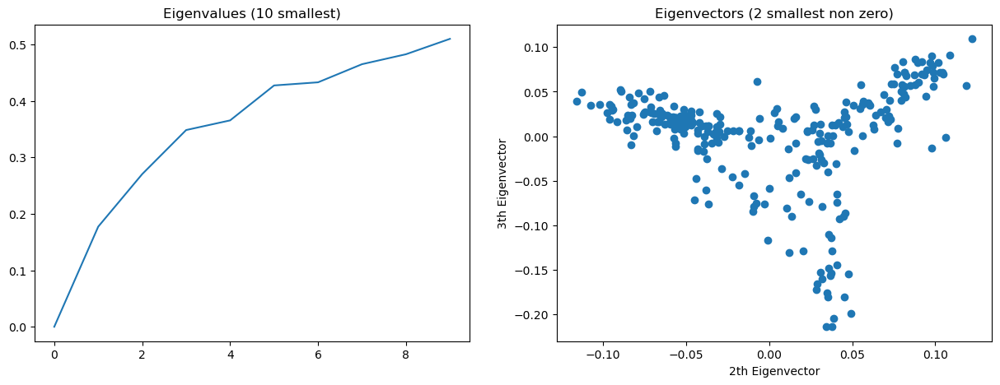

In [20]:
from numpy.linalg import eig, pinv

#wiring_adj = raw_adj[0] + raw_adj[1] + raw_adj[4]
wiring_adj = bullmore_adj_gap+bullmore_adj_chem
#wiring_adj += (chem_adj_bull + chem_adj_bull.T)*0.5

wiring_sym = ((wiring_adj + wiring_adj.T) > 0).astype(int)
#wiring_sym = wiring_adj

#wiring_sym = (chen_adj).astype(int)

sym_deg = wiring_sym.sum(axis=1)
wiring_sym = wiring_sym[sym_deg > 0][:, sym_deg > 0]

print(f"Symmetric wiring matrix has shape {wiring_sym.shape}")

d_mat = np.diag(wiring_sym.sum(axis=1))
print(wiring_sym.sum(axis=1).min(), wiring_sym.sum(axis=1).max())
L = d_mat - wiring_sym

L_norm = np.sqrt(pinv(d_mat)) @ L @ np.sqrt(pinv(d_mat))

eig_val, eig_vect = eig(L_norm)

sort_idx = np.argsort(eig_val)
eig_val = eig_val[sort_idx]
eig_vect = eig_vect[:, sort_idx]

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))

show_n_eig = 10
axes[0].plot(eig_val.real[:show_n_eig])
axes[0].set_title(f"Eigenvalues ({show_n_eig} smallest)")

eig_id = np.where(eig_val.real > 1e-5)[0][0]

axes[1].scatter(eig_vect[:, eig_id].real, eig_vect[:, eig_id+1].real)
axes[1].set_xlabel(f"{eig_id + 1}th Eigenvector")
axes[1].set_ylabel(f"{eig_id + 2}th Eigenvector")
axes[1].set_title("Eigenvectors (2 smallest non zero)")

Text(0.5, 1.0, 'Eigenvectors (2 smallest non zero)')

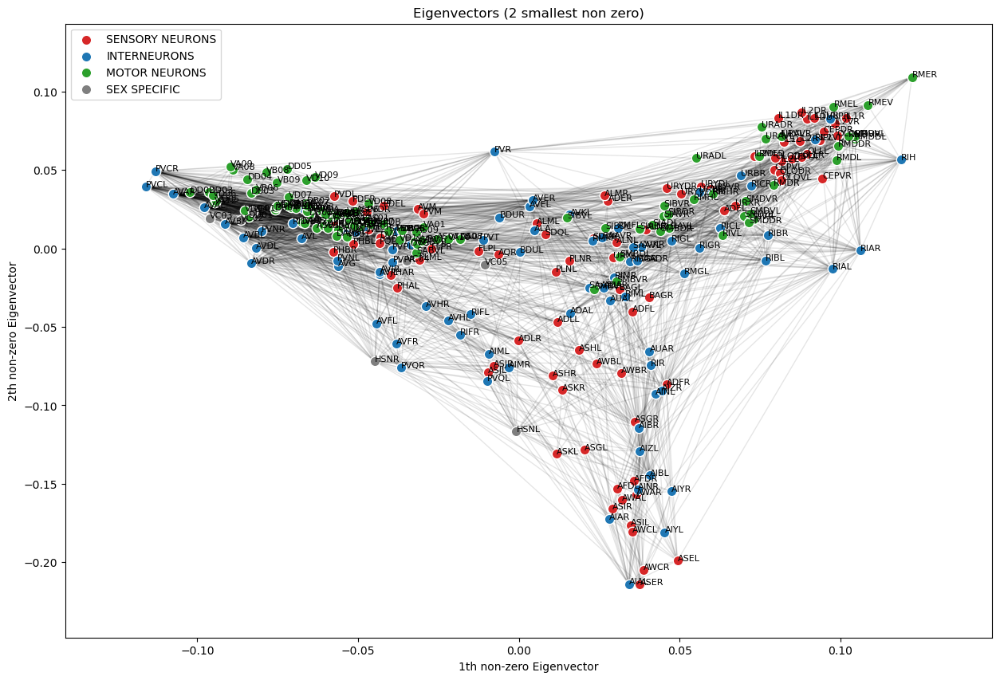

In [21]:
fig, axes = plt.subplots(figsize=(15, 10))

eig_id = np.where(eig_val.real > 1e-10)[0][0]

graph = nx.Graph(wiring_sym)
graph_pos = {i: (eig_vect[i, eig_id].real, eig_vect[i, eig_id+1].real) for i in range(wiring_sym.shape[0])}
nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.1)

axes.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

mycmap = plt.get_cmap("tab20")
colors = ["tab:red", "tab:blue", "tab:green", "tab:gray"]

for i, n_type in enumerate(neuron_def_df["Type"].unique()):
    neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]

    type_mask = np.array([lab in neurons_in_type.values for lab in bullmore_label])
    axes.scatter(eig_vect[type_mask, eig_id].real, eig_vect[type_mask, eig_id+1].real, color=colors[i], s=80, label=n_type, edgecolor="w", linewidths=1)

for i, neuron in enumerate(bullmore_label):
    axes.text(eig_vect[i, eig_id].real, eig_vect[i, eig_id+1].real, neuron, fontsize=8)

axes.legend()
axes.set_xlabel(f"{eig_id}th non-zero Eigenvector")
axes.set_ylabel(f"{eig_id + 1}th non-zero Eigenvector")
axes.set_title("Eigenvectors (2 smallest non zero)")

# Unidrected modularity

Symmetric wiring matrix has shape (279, 279)


Text(0.5, 1.0, 'Eigenvectors (2 smallest non zero)')

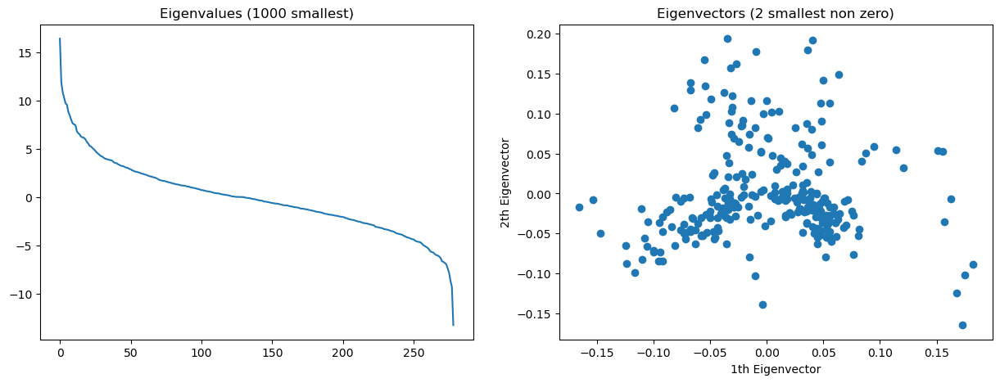

In [22]:
wiring_adj = bullmore_adj_gap+bullmore_adj_chem

wiring_sym = ((wiring_adj + wiring_adj.T) > 0).astype(int)
print(f"Symmetric wiring matrix has shape {wiring_sym.shape}")

#wiring_sym = wiring_sym_chen

undir_mod = dgsp.modularity_matrix(wiring_sym)

eig_val, eig_vect = eig(undir_mod)

sort_idx = np.flip(np.argsort(eig_val))
eig_val = eig_val[sort_idx]
eig_vect = eig_vect[:, sort_idx]

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))

show_n_eig = 1000
axes[0].plot(eig_val.real[:show_n_eig])
axes[0].set_title(f"Eigenvalues ({show_n_eig} smallest)")

eig_id = np.where(eig_val.real > 1e-5)[0][0]

axes[1].scatter(eig_vect[:, eig_id].real, eig_vect[:, eig_id+1].real)
axes[1].set_xlabel(f"{eig_id + 1}th Eigenvector")
axes[1].set_ylabel(f"{eig_id + 2}th Eigenvector")
axes[1].set_title("Eigenvectors (2 smallest non zero)")

Text(0.5, 1.0, 'Eigenvectors (2 smallest non zero)')

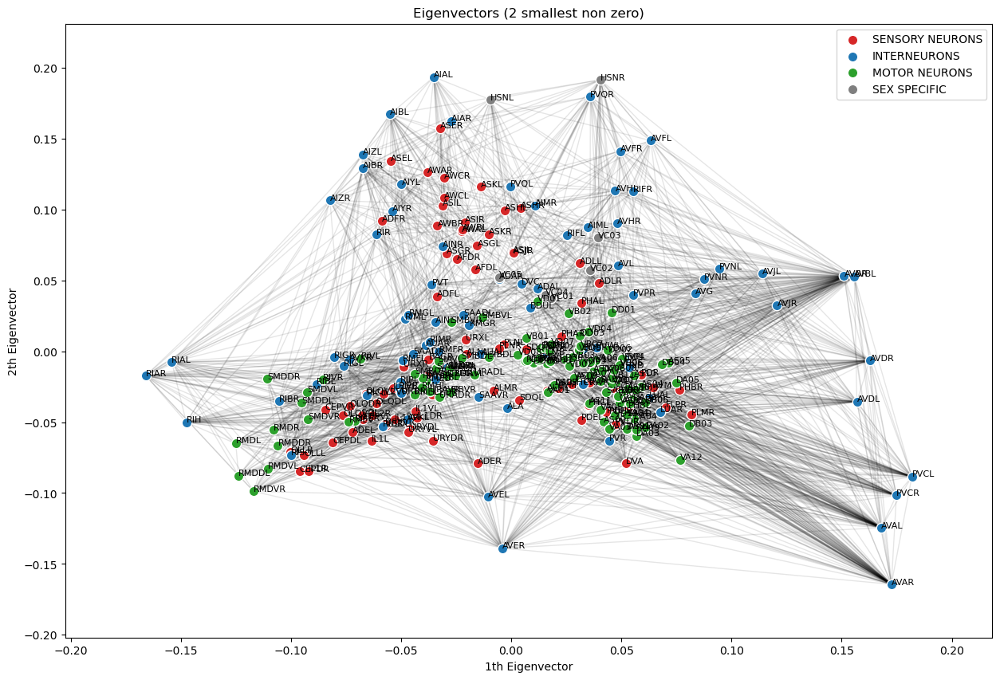

In [23]:
fig, axes = plt.subplots(figsize=(15, 10))

eig_id = np.where(eig_val.real > 1e-10)[0][0]

graph = nx.Graph(wiring_sym)
graph_pos = {i: (eig_vect[i, eig_id].real, eig_vect[i, eig_id+1].real) for i in range(wiring_sym.shape[0])}
nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.1)

axes.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

mycmap = plt.get_cmap("tab20")
colors = ["tab:red", "tab:blue", "tab:green", "tab:gray"]

for i, n_type in enumerate(neuron_def_df["Type"].unique()):
    neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]

    type_mask = np.array([lab in neurons_in_type.values for lab in bullmore_label])
    #type_mask = np.array([lab in neurons_in_type.values for lab in neuron_def_df.Neuron])
    axes.scatter(eig_vect[type_mask, eig_id].real, eig_vect[type_mask, eig_id+1].real, color=colors[i], s=80, label=n_type, edgecolor="w", linewidths=1)

for i, neuron in enumerate(bullmore_label):
#for i, neuron in enumerate(neuron_def_df.Neuron):
    axes.text(eig_vect[i, eig_id].real, eig_vect[i, eig_id+1].real, neuron, fontsize=8)

axes.legend()
axes.set_xlabel(f"{eig_id + 1}th Eigenvector")
axes.set_ylabel(f"{eig_id + 2}th Eigenvector")
axes.set_title("Eigenvectors (2 smallest non zero)")

# Directed case

1
Asymmetric wiring matrix has shape (279, 279)
k_out 0 49
k_in 0 53
2194 connections
233 symmetric connections
1961 asymmetric connections
mean of V^T U: -0.0695546973438501


Text(0.5, 1.0, 'Eigenvectors (2 smallest non zero)')

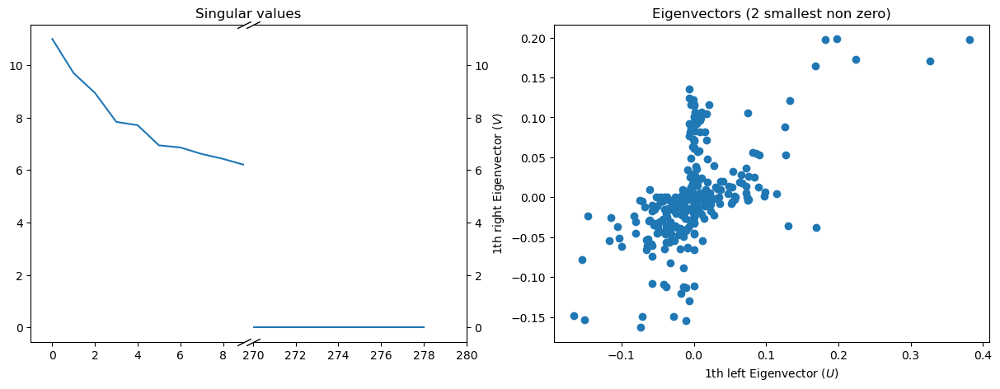

In [7]:
from matplotlib.gridspec import GridSpec, GridSpecFromSubplotSpec
from numpy.linalg import svd

use_bullmore = True
if use_bullmore:
    wiring_adj = (bullmore_adj_gap).astype(int) + (bullmore_adj_chem).astype(int)
    wiring_adj = bullmore_adj_chem
    thresh = 0

    nodes_labels = bullmore_label
else:
    wiring_adj = gap_adj_clean + chem_adj_clean
    wiring_adj = manual_chem
    #wiring_adj = ((manual_chem + manual_gap) > 0).astype(int)
    #wiring_adj = chem_adj_clean
    thresh = 0

    nodes_labels = neuron_def_df.Neuron
    nodes_labels = all_neurons

wiring_adj -= np.diag(np.diag(wiring_adj))

wiring_sym = (wiring_adj > thresh).astype(int)
wiring_sym = wiring_adj.astype(int)

print(wiring_sym.max())

wiring_mod = dgsp.modularity_matrix(wiring_sym, null_model="outin")

#sym_deg = wiring_sym.sum(axis=1)
#wiring_sym = wiring_sym[sym_deg > 0][:, sym_deg > 0]

print(f"Asymmetric wiring matrix has shape {wiring_sym.shape}")

d_mat = np.diag(wiring_sym.sum(axis=1))
print("k_out", wiring_sym.sum(axis=1).min(), wiring_sym.sum(axis=1).max())
print("k_in", wiring_sym.sum(axis=0).min(), wiring_sym.sum(axis=0).max())

print(wiring_sym.sum(), "connections")
n_sym = np.logical_and(wiring_sym, wiring_sym.T).sum()//2
print(n_sym, "symmetric connections")
print(wiring_sym.sum() - n_sym, "asymmetric connections")

#U, S, Vh = svd(wiring_mod)
U, S, Vh = dgsp.sorted_SVD(wiring_mod, fix_negative=False)
V = Vh.T

print("mean of V^T U:", np.diag(Vh@U).mean())

sort_idx = np.flip(np.argsort(S))
S = S[sort_idx]
U = U[:, sort_idx]
V = V[:, sort_idx]

show_n_eig = 9
# Plotting the singular values
#fig = plt.figure(figsize=(15, 5))
#gs = GridSpec(1, 2, wspace=0.25)

fig, all_axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))

gs1 = GridSpecFromSubplotSpec(1, 2, subplot_spec=all_axes[0], wspace=.04)

axes = [fig.add_subplot(gs1[0]), fig.add_subplot(gs1[1]), fig.add_subplot(all_axes[1])]

# Clear the 1st subplot (in the background)
all_axes[0].set_title("Singular values")
all_axes[0].set_xticks([])
all_axes[0].set_yticks([])
for loc, s in all_axes[0].spines.items():
    s.set_visible(False)

axes[0].plot(S)
axes[1].plot(S)

axes[0].set_xlim(-1, show_n_eig)
axes[1].set_xlim(len(S)-show_n_eig, len(S)+1)

axes[0].spines.right.set_visible(False)
axes[1].spines.left.set_visible(False)

axes[1].yaxis.tick_right()

# From matplotlib examples
d = .5  # proportion of vertical to horizontal extent of the slanted line
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
axes[0].plot([1, 1], [1, 0], transform=axes[0].transAxes, **kwargs)
axes[1].plot([0, 0], [0, 1], transform=axes[1].transAxes, **kwargs)

eig_id = np.where(S > 1e-5)[0][0]

axes[2].scatter(U[:, eig_id], V[:, eig_id])
axes[2].set_xlabel(f"{eig_id + 1}th left Eigenvector ($U$)")
axes[2].set_ylabel(f"{eig_id + 1}th right Eigenvector ($V$)")
axes[2].set_title("Eigenvectors (2 smallest non zero)")

Text(0.5, 1.0, 'Eigenmodes embedding of C. Elegans connectome s=10.99')

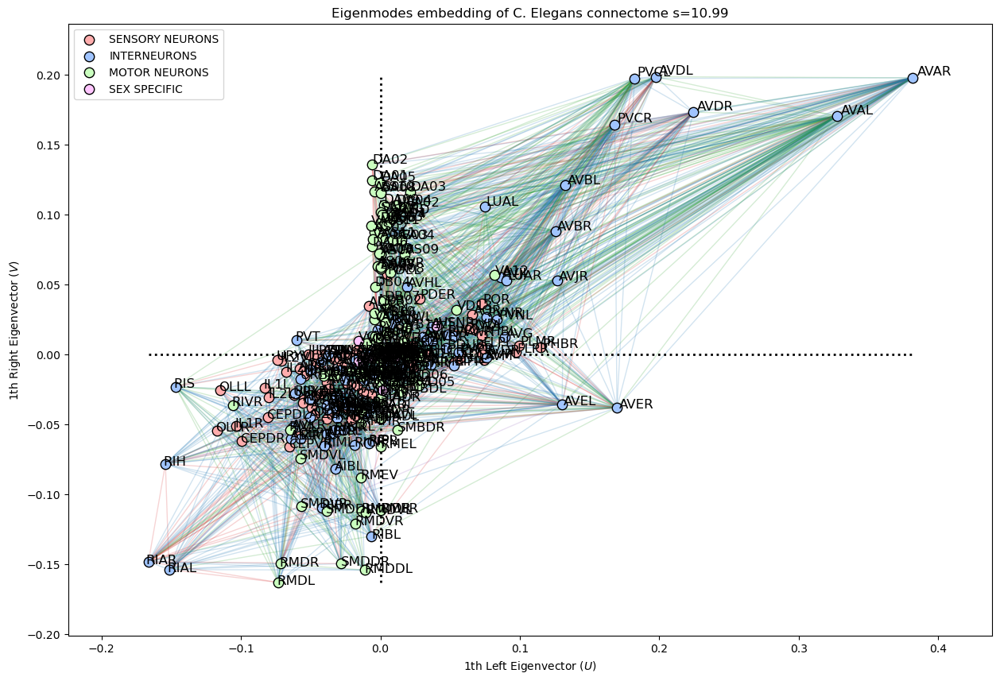

In [8]:
fig, axes = plt.subplots(figsize=(15, 10))

eig_id = np.where(S > 1e-10)[0][0]

mycmap = plt.get_cmap("tab20")
colors_edge = np.array(["tab:red", "tab:blue", "tab:green", "tab:purple"])
colors = np.array(palette_rgb)

graph = nx.DiGraph(wiring_sym)
graph_pos = {i: (U[i, eig_id], V[i, eig_id]) for i in range(wiring_sym.shape[0])}

colors = np.array(palette_rgb)
edge_colors = np.zeros_like(np.array(graph.edges())[:, 0])
for i, (_, target) in enumerate(graph.edges()):
    edge_colors[i] = neuron_def_df[neuron_def_df["Neuron"] == nodes_labels[target]]["Type_num"].values[0]

#nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.07)
nx.draw_networkx_edges(nx.Graph(wiring_sym), pos=graph_pos, edge_color=colors_edge[edge_colors], alpha=.2)
#nx.draw_networkx_edges(graph, pos=graph_pos, edge_color=colors_edge[edge_colors], alpha=.2, width=1,
#                       ax=axes, connectionstyle="arc3,rad=0.2")

axes.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

for i, n_type in enumerate(neuron_def_df["Type"].unique()):
    neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]


    #type_mask = np.array([lab in neurons_in_type.values for lab in bullmore_label])
    type_mask = np.array([lab in neurons_in_type.values for lab in nodes_labels])
    axes.scatter(U[type_mask, eig_id], V[type_mask, eig_id], color=colors[i], s=80, label=n_type,
                 zorder=3, edgecolor="k", lw=1, alpha=1)

label_filter = ["AVAL", "AVAR", "AVEL", "AVER", "RIAR", "RIAL"]
#for i, neuron in enumerate(bullmore_label):
for i, neuron in enumerate(nodes_labels):
    #if neuron in label_filter:
    #if neuron not in ["AVAL", "AVAR"]:
    #if neuron not in ["PVDR", "PVDL", "ALA"]:
    if True:
        axes.text(1.01*U[i, eig_id], 1.01*V[i, eig_id], neuron, fontsize=12)

x_max, y_max = np.max(np.vstack([U[:, eig_id], V[:, eig_id]]), axis=1)
x_min, y_min = np.min(np.vstack([U[:, eig_id], V[:, eig_id]]), axis=1)

abs_min = max([x_min, y_min])
abs_max = min([x_max, y_max])

#axes.plot([abs_min, abs_max], [abs_min, abs_max], color="tab:orange")
axes.plot([0, 0], [y_min, y_max], ls=":", lw=2, color="k")
axes.plot([x_min, x_max], [0, 0], ls=":", lw=2, color="k")

axes.legend()
axes.set_xlabel(f"{eig_id + 1}th Left Eigenvector ($U$)")
axes.set_ylabel(f"{eig_id + 1}th Right Eigenvector ($V$)")
axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" s={S[eig_id]:1.2f}")
#axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" {U[:, eig_id].T@V[:, eig_id]:1.2f}")

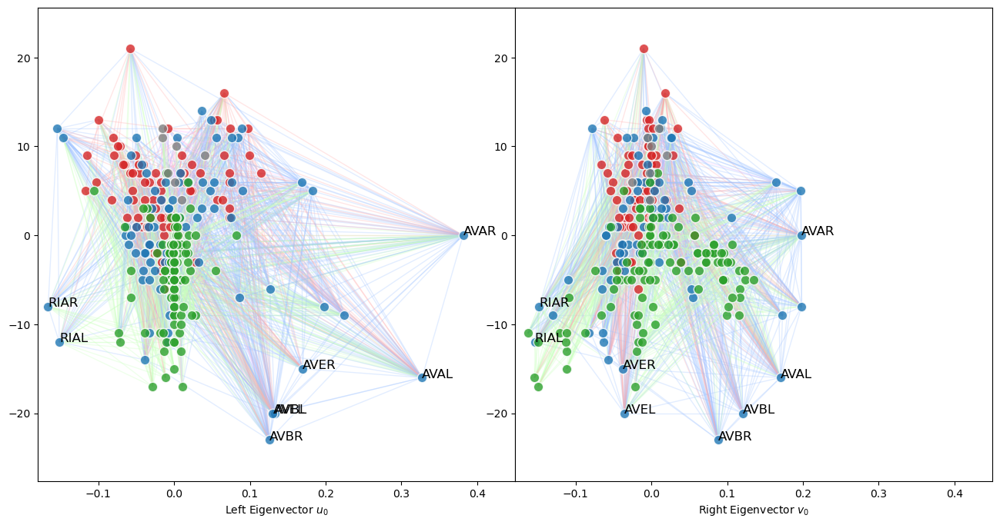

In [283]:
deg_diff = (wiring_sym.sum(axis=1) - wiring_sym.sum(axis=0)).astype(float)
#deg_diff /= np.max(np.abs(deg_diff))

fig, axes = plt.subplots(ncols=2, figsize=(16, 8), sharey=True, gridspec_kw={"wspace":0})

mycmap = plt.get_cmap("tab20")
colors = ["tab:red", "tab:blue", "tab:green", "tab:gray"]

vectors = [U, V]
for ax_i, ax in enumerate(axes):

    graph = nx.Graph(wiring_sym)
    graph_pos = {i: (vectors[ax_i][i, eig_id], deg_diff[i]) for i in range(wiring_sym.shape[0])}

    edge_colors = np.zeros_like(np.array(graph.edges())[:, 0])
    for i, (_, target) in enumerate(graph.edges()):
        edge_colors[i] = neuron_def_df[neuron_def_df["Neuron"] == bullmore_label[target]]["Type_num"].values[0]

    #nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.05)
    #nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.02, ax=ax)
    nx.draw_networkx_edges(graph, pos=graph_pos, edge_color=np.array(palette_rgb)[edge_colors], alpha=.3, ax=ax)

    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.set_xlim(-0.18, 0.45)

    for i, n_type in enumerate(neuron_def_df["Type"].unique()):
        neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]


        #type_mask = np.array([lab in neurons_in_type.values for lab in bullmore_label])
        type_mask = np.array([lab in neurons_in_type.values for lab in nodes_labels])
        ax.scatter(vectors[ax_i][type_mask, eig_id], deg_diff[type_mask], color=colors[i], s=80, label=n_type,
                    zorder=3, edgecolor="w", lw=1, alpha=.8)

    label_filter = ["AVAL", "AVAR", "AVEL", "AVER", "RIAR", "RIAL", "AVBL", "AVBR"]
    #for i, neuron in enumerate(bullmore_label):
    for i, neuron in enumerate(nodes_labels):
        if neuron in label_filter:
        #if True:
            ax.text(vectors[ax_i][i, eig_id], deg_diff[i], neuron, fontsize=12)
            #ax.text(1.01*U[i, eig_id], 1.01*V[i, eig_id], neuron, fontsize=12)
    
    ax.set_xlabel(f"{['Left', 'Right'][ax_i]} Eigenvector {['$u_{0}$', '$v_{0}$'][ax_i]}")

In [284]:
deg_diff = (wiring_sym.sum(axis=1) - wiring_sym.sum(axis=0)).astype(float)

import plotly.express as px

df = pd.DataFrame(np.vstack([U[:, 0]/(np.abs(U[:, 0]).max()*0.95),
                             V[:, 0]/(np.abs(V[:, 0]).max()*0.95),
                             deg_diff/(np.abs(deg_diff).max()*0.95)]).T,
                             columns=["U", "V", "Deg Diff"])
df["Type"] = bullmore_type
df["Neuron"] = bullmore_label
df["Size"] = 100

range_val = 1

fig = px.scatter_3d(df, x="U", y="V", z="Deg Diff", color="Type", text="Neuron", size="Size",
                    range_x=[-range_val, range_val], range_y=[-range_val, range_val], range_z=[-range_val, range_val],
                    height=1200, width=1500)
fig.show()


IndexError: boolean index did not match indexed array along dimension 0; dimension is 283 but corresponding boolean dimension is 279

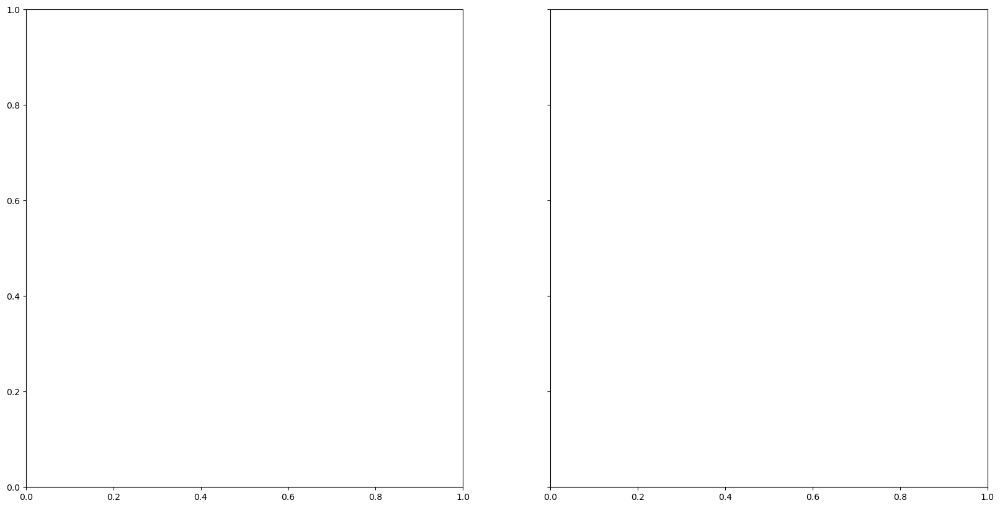

In [286]:
fig, axes = plt.subplots(ncols=2, figsize=(20, 10), sharex=True, sharey=True)

eig_id = np.where(eig_val.real > 1e-10)[0][0]

x_pos = bullmore_pos[:, 0]
y_pos = bullmore_pos[:, 0]
y_pos = eig_vect[:, eig_id].real

mycmap = plt.get_cmap("tab20")
colors = ["tab:red", "tab:blue", "tab:green", "tab:gray"]

for i, n_type in enumerate(neuron_def_df["Type"].unique()):
    neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]

    type_mask = np.array([lab in neurons_in_type.values for lab in bullmore_label])
    #type_mask = np.array([lab in neurons_in_type.values for lab in neuron_def_df.Neuron])
    axes[0].scatter(y_pos[type_mask], U[type_mask, eig_id], color=colors[i], s=80, label=n_type, edgecolor="w", linewidths=1)
    axes[1].scatter(y_pos[type_mask], V[type_mask, eig_id], color=colors[i], s=80, label=n_type, edgecolor="w", linewidths=1)
    #axes.scatter(x_pos[type_mask], y_pos[type_mask], color=colors[i], s=80, label=n_type, edgecolor="w", linewidths=1)

for i, neuron in enumerate(bullmore_label):
    axes[0].text(1.01*y_pos[i], 1.01*U[i, eig_id], neuron, fontsize=12)
    axes[1].text(1.01*y_pos[i], 1.01*V[i, eig_id], neuron, fontsize=12)

for ax in axes:
    ax.plot([y_pos.min(), y_pos.max()], [y_pos.min(), y_pos.max()], color="k", ls="--")

    ax.legend()
    ax.set_xlabel("Undirected eigenvector")
    ax.set_ylabel("Directed singular vector")
    ax.set_title("Eigenvectors (2 smallest non zero)")

### 1D representation of $U$ and $V$

[array([0.64482479, 1.        , 0.98300348]), array([0.71071892, 0.91505723, 1.        ]), array([1.        , 0.89288805, 0.96844284]), array([0.96156163, 0.90425009, 1.        ]), array([1.        , 0.64653286, 0.65971329]), array([1.        , 0.66243994, 0.36293423]), array([0.57920055, 0.96843431, 1.        ]), array([0.72346834, 0.99026954, 1.        ]), array([0.9702901, 0.9713109, 1.       ]), array([0.9354642 , 1.        , 0.87794006]), array([0.64559128, 0.65683847, 1.        ]), array([0.79698537, 0.80516912, 1.        ]), array([0.69309221, 0.54242235, 1.        ]), array([0.82837696, 0.54928065, 1.        ]), array([0.6508443 , 0.95845115, 1.        ]), array([0.73892015, 0.97304828, 1.        ]), array([1.        , 0.88264329, 0.88264329]), array([1.        , 0.94973953, 0.97318628]), array([1.        , 0.87348242, 0.96564135]), array([1.        , 0.86340426, 0.76043089]), array([0.89153473, 1.        , 0.65912777]), array([0.98800406, 1.        , 0.63857917]), array([0.925

(-0.02, 0.03)

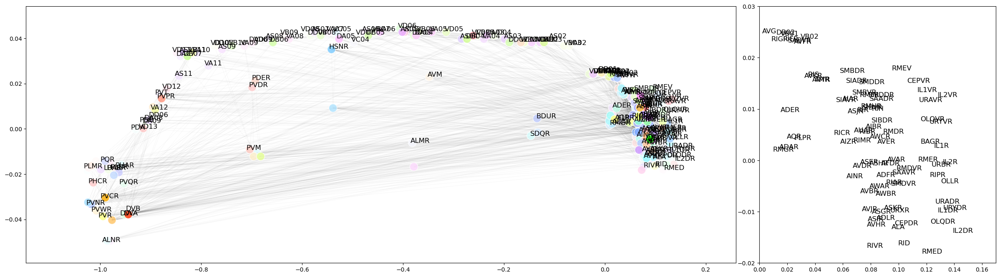

In [287]:
from matplotlib.colors import hsv_to_rgb

angles = np.arctan2(U[:, eig_id], V[:, eig_id])
angles = np.arctan2(V[:, eig_id], U[:, eig_id])

angles_prop = angles/(2*np.pi)
angles_prop[angles_prop < 0] = 1+angles_prop[angles_prop < 0]

percent_radius = 0.6
radius = np.sqrt(U[:, eig_id]**2 + V[:, eig_id]**2)
radius = np.clip(radius/(radius.max()*percent_radius), a_min=0, a_max=1)

by_radius = np.argsort(radius)

eig_id = np.where(S > 1e-10)[0][0]

x_pos = bullmore_pos[:, 0]
y_pos = bullmore_pos[:, 1]

graph_pos = {i: (x, y) for i, (x, y) in enumerate(zip(x_pos, y_pos))}

cmap = plt.get_cmap("hsv", 100)
colors = cmap((100*angles_prop).astype(int))

colors = [hsv_to_rgb([a, r, 1]) for a, r in zip(angles_prop, radius)]
print(colors)

fig, axes = plt.subplots(ncols=2, figsize=(30, 8), gridspec_kw={"wspace":.05, "width_ratios":[3, 1]})

graph = nx.Graph(wiring_sym)
nx.draw_networkx_edges(graph, pos=graph_pos, ax=axes[0], alpha=.025)

axes[0].tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

x_thresh = 0

axes[0].scatter(np.array(x_pos)[by_radius], np.array(y_pos)[by_radius], color=np.array(colors)[by_radius], s=200, alpha=.8, edgecolor="w", linewidths=1)

#axes[1].scatter(np.array(x_pos)[x_pos > x_thresh], np.array(y_pos)[x_pos > x_thresh], color=np.array(colors)[[x_pos > x_thresh]], s=200, alpha=.8, edgecolor="w", linewidths=1)

for i, neuron in enumerate(bullmore_label):
    if not neuron.endswith("L"):
        axes[0].text(1.01*x_pos[i], 1.01*y_pos[i], neuron, fontsize=12, alpha=1)#radius[by_radius][i])

        if x_pos[i] > x_thresh:
            axes[1].text(1.01*x_pos[i], 1.01*y_pos[i], neuron, fontsize=12, alpha=1)

axes[1].set_xlim(0, 0.17)
axes[1].set_ylim(-0.02, 0.03)
#axes[0, 0].set_xlabel("X position")
#axes[0, 0].set_ylabel("Y position")
#axes[0, 0].set_title("1D representation of Bi-Modularity")

[array([0.98808727, 0.94360363, 1.        ]), array([0.92157463, 0.88663694, 1.        ]), array([0.82850397, 0.9709915 , 1.        ]), array([0.92479238, 1.        , 0.8961722 ]), array([0.90294151, 0.98995668, 1.        ]), array([0.81373661, 0.9056112 , 1.        ]), array([1.        , 0.84620689, 0.86326149]), array([1.        , 0.83469562, 0.84299612]), array([0.96405457, 0.95565447, 1.        ]), array([0.93846638, 0.91422875, 1.        ]), array([0.85109677, 0.88024989, 1.        ]), array([0.86936832, 0.90503375, 1.        ]), array([0.77889793, 0.74286064, 1.        ]), array([0.79974158, 0.81358639, 1.        ]), array([1.        , 0.89178629, 0.91324676]), array([1.        , 0.98066027, 0.99991297]), array([0.89157724, 1.        , 1.        ]), array([0.87519058, 0.98559629, 1.        ]), array([0.84048784, 0.87711436, 1.        ]), array([0.84585697, 0.88846936, 1.        ]), array([0.80308083, 0.86325606, 1.        ]), array([0.74441124, 0.81578186, 1.        ]), array([0.

(-0.18303458974319808, 0.4194792107347608)

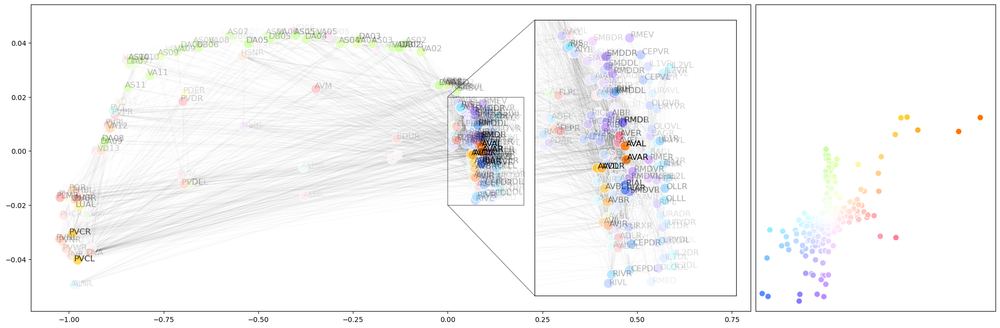

In [288]:
from matplotlib.colors import hsv_to_rgb

angles = np.arctan2(U[:, eig_id], V[:, eig_id])
angles = np.arctan2(V[:, eig_id], U[:, eig_id])

angles_prop = angles/(2*np.pi)
angles_prop[angles_prop < 0] = 1+angles_prop[angles_prop < 0]

angle_offset = 0
angles_prop += angle_offset

percent_radius = 0.8
radius = np.sqrt(U[:, eig_id]**2 + V[:, eig_id]**2)
radius = np.clip(radius/(radius.max()*percent_radius), a_min=0, a_max=1)

by_radius = np.argsort(radius)

eig_id = np.where(S > 1e-10)[0][0]

x_pos = bullmore_pos[:, 0]
y_pos = bullmore_pos[:, 1]

graph_pos = {i: (x, y) for i, (x, y) in enumerate(zip(x_pos, y_pos))}

cmap = plt.get_cmap("hsv", 100)
colors = cmap((100*angles_prop).astype(int))

colors = [hsv_to_rgb([a, r, 1]) for a, r in zip(angles_prop, radius)]
print(colors)

fig, axes = plt.subplots(ncols=2, figsize=(25, 8), gridspec_kw={"wspace":0.01, "width_ratios":[3, 1]})

graph = nx.Graph(wiring_sym)
nx.draw_networkx_edges(graph, pos=graph_pos, ax=axes[0], alpha=.025)

axes[0].tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

#axes[0].scatter(np.array(x_pos), np.array(y_pos), color=np.array(colors), s=200, alpha=.8, edgecolor="w", linewidths=1)
axes[0].scatter(np.array(x_pos)[by_radius], np.array(y_pos)[by_radius], color=np.array(colors)[by_radius], s=200, alpha=.8, edgecolor="w", linewidths=1, zorder=2)

for i, neuron in enumerate(bullmore_label):
    axes[0].text(1.01*x_pos[i], 1.01*y_pos[i], neuron, fontsize=12, alpha=radius[i])
    #axes.text(1.01*x_pos[i], 1.01*y_pos[i], neuron, fontsize=12, alpha=radius[by_radius][i])

# Plotting the zoom

#x1, x2, y1, y2 = 0, 0.2, -0.02, 0.02
#axes.set_ylim(-0.1, 0.05)
x1, x2, y1, y2 = 0, 0.2, -0.02, 0.02
axes[0].set_xlim(-1.1, .8)

mask = np.logical_and(x_pos > x1, y_pos < y1)
subgraph = nx.Graph(wiring_sym[mask][:, mask])

axins = axes[0].inset_axes(
    [0.7, 0.05, 0.28, 0.9],
    #[0.7, 0.05, 0.28, 0.45],
    #[0.5, 0.5, 0.47, 0.47],
    xlim=(x1, x2), ylim=(y1, y2), xticklabels=[], yticklabels=[])
#axins.imshow(Z2, origin="lower")
axins.scatter(np.array(x_pos)[by_radius], np.array(y_pos)[by_radius], color=np.array(colors)[by_radius], s=200, alpha=.8, edgecolor="w", linewidths=1, zorder=2)
nx.draw_networkx_edges(graph, pos=graph_pos, ax=axins, alpha=.025)

for i, neuron in enumerate(bullmore_label):
    if x_pos[i] > x1 and y_pos[i] < y2:
        axins.text(1.01*x_pos[i], 1.01*y_pos[i], neuron, fontsize=12, alpha=radius[i])

axes[0].indicate_inset_zoom(axins, edgecolor="black")

axes[1].scatter(U[:, eig_id], V[:, eig_id], color=colors, s=80, edgecolor="w", linewidths=1)
axes[1].set_xticks([])
axes[1].set_yticks([])
minval = np.concatenate([U[:, eig_id], V[:, eig_id]]).min()
maxval = np.concatenate([U[:, eig_id], V[:, eig_id]]).max()
axes[1].set_xlim(minval*1.1, maxval*1.1)
axes[1].set_ylim(minval*1.1, maxval*1.1)

#axes[0, 0].set_xlabel("X position")
#axes[0, 0].set_ylabel("Y position")
#axes[0, 0].set_title("1D representation of Bi-Modularity")

### Looking at a subset of nodes

In [200]:
eig_id = np.where(S > 1e-10)[0][0]

label_filter = ["AVAL", "AVAR", "AVEL", "AVER", "RIAR", "RIAL"]
label_filter = ["AVEL", "AVER"]
roi_ids = np.where([lab in label_filter for lab in bullmore_label])[0]

connected_mask = (wiring_sym[roi_ids].sum(axis=0) + wiring_sym[:, roi_ids].sum(axis=1)) > 0
connected_mask[roi_ids] = True

wiring_masked = wiring_sym[connected_mask][:, connected_mask]
U_masked = U[connected_mask]
V_masked = V[connected_mask]
label_masked = bullmore_label[connected_mask]

Text(0.5, 1.0, 'Eigenmodes embedding of C. Elegans connectome s=10.99 (Focus on AVEL AVER)')

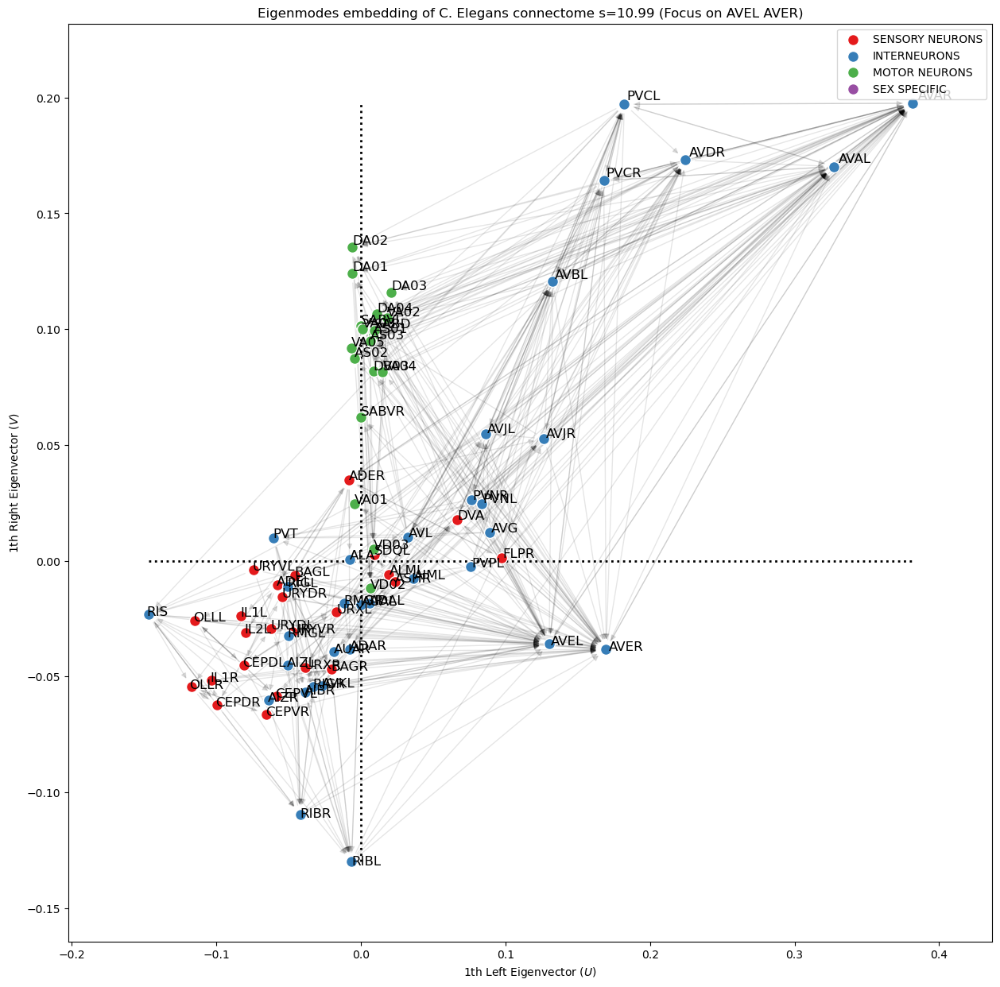

In [201]:
fig, axes = plt.subplots(figsize=(15, 15))

graph = nx.DiGraph(wiring_masked)
graph_pos = {i: (U_masked[i, eig_id], V_masked[i, eig_id]) for i in range(wiring_masked.shape[0])}
#nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.05)
nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.1)

axes.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

#mycmap = plt.get_cmap("tab10")
mycmap = plt.get_cmap("Set1")
colors = ["tab:red", "tab:blue", "tab:green", "tab:gray"]

for i, n_type in enumerate(neuron_def_df["Type"].unique()):
    neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]

    type_mask = np.array([lab in neurons_in_type.values for lab in label_masked])
    axes.scatter(U_masked[type_mask, eig_id], V_masked[type_mask, eig_id], color=mycmap(i), s=100, label=n_type,
                  zorder=3, edgecolor="w", lw=1)

for i, neuron in enumerate(label_masked):
    #if neuron in label_filter:
    if True:
        axes.text(1.01*U_masked[i, eig_id], 1.01*V_masked[i, eig_id], neuron, fontsize=12)

x_max, y_max = np.max(np.vstack([U_masked[:, eig_id], V_masked[:, eig_id]]), axis=1)
x_min, y_min = np.min(np.vstack([U_masked[:, eig_id], V_masked[:, eig_id]]), axis=1)

abs_min = max([x_min, y_min])
abs_max = min([x_max, y_max])

#axes.plot([abs_min, abs_max], [abs_min, abs_max], color="tab:orange")
axes.plot([0, 0], [y_min, y_max], ls=":", lw=2, color="k")
axes.plot([x_min, x_max], [0, 0], ls=":", lw=2, color="k")

axes.legend()
axes.set_xlabel(f"{eig_id + 1}th Left Eigenvector ($U$)")
axes.set_ylabel(f"{eig_id + 1}th Right Eigenvector ($V$)")
axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" s={S[eig_id]:1.2f} (Focus on {' '.join(label_filter)})")
#axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" {U[:, eig_id].T@V[:, eig_id]:1.2f}")

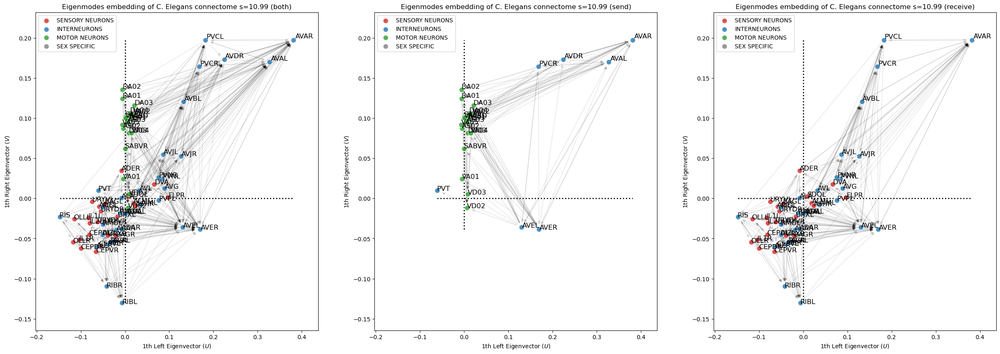

In [202]:
fig, axes = plt.subplots(ncols=3, figsize=(30, 10), sharex=True, sharey=True)

eig_id = np.where(S > 1e-10)[0][0]

label_filter = ["AVAL", "AVAR", "AVEL", "AVER", "RIAR", "RIAL"]
label_filter = ["AVEL", "AVER"]

regional_mask = np.where([lab in label_filter for lab in bullmore_label])[0]

for ax_i, ax in enumerate(axes):

    if ax_i == 0:
        connected_mask = (wiring_sym[regional_mask].sum(axis=0) + wiring_sym[:, regional_mask].sum(axis=1)) > 0
    elif ax_i == 1:
        connected_mask = (wiring_sym[regional_mask].sum(axis=0)) > 0
    else:
        connected_mask = (wiring_sym[:, regional_mask].sum(axis=1)) > 0
    
    connected_mask[regional_mask] = True

    wiring_masked = wiring_sym[connected_mask][:, connected_mask]
    U_masked = U[connected_mask]
    V_masked = V[connected_mask]
    label_masked = bullmore_label[connected_mask]

    graph = nx.DiGraph(wiring_masked)
    graph_pos = {i: (U_masked[i, eig_id], V_masked[i, eig_id]) for i in range(wiring_masked.shape[0])}
    #nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.05)
    nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.1, ax=ax)


    #mycmap = plt.get_cmap("tab10")
    colors = ["tab:red", "tab:blue", "tab:green", "tab:gray"]

    for i, n_type in enumerate(neuron_def_df["Type"].unique()):
        neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]

        type_mask = np.array([lab in neurons_in_type.values for lab in label_masked])
        ax.scatter(U_masked[type_mask, eig_id], V_masked[type_mask, eig_id], color=colors[i], s=80, label=n_type,
                    zorder=3, edgecolor="w", lw=1, alpha=.8)

    for i, neuron in enumerate(label_masked):
        #if neuron in label_filter:
        if True:
            ax.text(1.01*U_masked[i, eig_id], 1.01*V_masked[i, eig_id], neuron, fontsize=12)

    x_max, y_max = np.max(np.vstack([U_masked[:, eig_id], V_masked[:, eig_id]]), axis=1)
    x_min, y_min = np.min(np.vstack([U_masked[:, eig_id], V_masked[:, eig_id]]), axis=1)

    abs_min = max([x_min, y_min])
    abs_max = min([x_max, y_max])

    #axes.plot([abs_min, abs_max], [abs_min, abs_max], color="tab:orange")
    ax.plot([0, 0], [y_min, y_max], ls=":", lw=2, color="k")
    ax.plot([x_min, x_max], [0, 0], ls=":", lw=2, color="k")

    ax.legend()
    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.set_xlabel(f"{eig_id + 1}th Left Eigenvector ($U$)")
    ax.set_ylabel(f"{eig_id + 1}th Right Eigenvector ($V$)")
    ax.set_title("Eigenmodes embedding of C. Elegans connectome" + f" s={S[eig_id]:1.2f}" + f" ({['both', 'send', 'receive'][ax_i]})")
    #ax.set_title("Eigenmodes embedding of C. Elegans connectome" + f" s={S[eig_id]:1.2f}" + f" (Focus on {' '.join(label_filter)}")# {['both', 'out', 'in'][i]})")
    #axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" {U[:, eig_id].T@V[:, eig_id]:1.2f}")

## Sinks and Sources

69
118


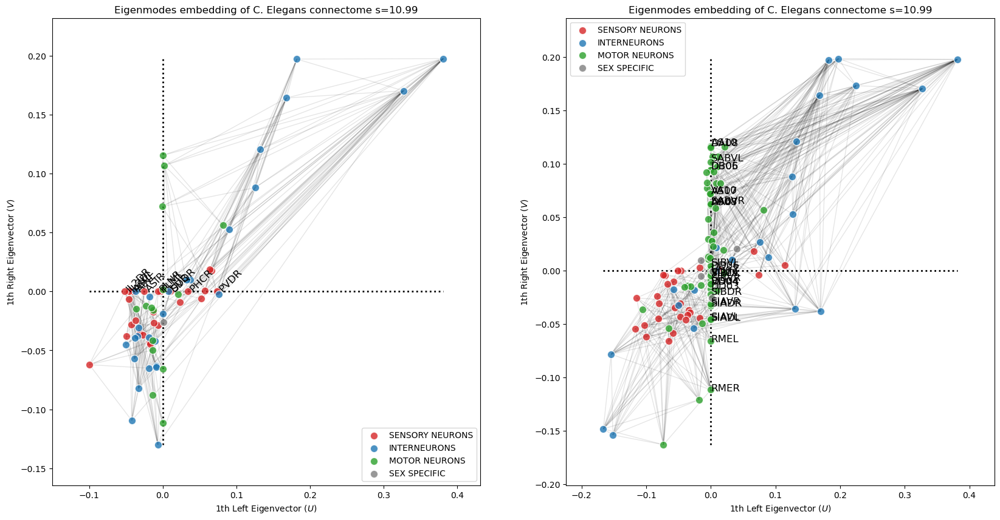

In [204]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))

eig_id = np.where(S > 1e-10)[0][0]

for ax_i, ax in enumerate(axes):

    wiring_red = wiring_sym.copy()
    sink_source = wiring_red.sum(axis=ax_i) == 0

    mask = (wiring_red[sink_source].sum(axis=0) > 0) + (wiring_red[:, sink_source].sum(axis=1) > 0)
    mask = (mask + sink_source).astype(bool)

    print(sum(mask))

    wiring_red = wiring_red[mask][:, mask]
    labels_red = nodes_labels[mask]
    U_red = U[mask]
    V_red = V[mask]

    graph = nx.Graph(wiring_red)
    graph_pos = {i: (U_red[i, eig_id], V_red[i, eig_id]) for i in range(wiring_red.shape[0])}
    #nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.05)
    nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.1, ax=ax)

    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

    mycmap = plt.get_cmap("tab20")
    colors = ["tab:red", "tab:blue", "tab:green", "tab:gray"]

    for i, n_type in enumerate(neuron_def_df["Type"].unique()):
        neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]

        type_mask = np.array([lab in neurons_in_type.values for lab in labels_red])
        ax.scatter(U_red[type_mask, eig_id], V_red[type_mask, eig_id], color=colors[i], s=80, label=n_type,
                    zorder=3, edgecolor="w", lw=1, alpha=.8)

    label_filter = ["AVAL", "AVAR", "AVEL", "AVER", "RIAR", "RIAL"]
    #for i, neuron in enumerate(bullmore_label):
    for i, neuron in enumerate(labels_red):
        #if neuron in label_filter:
        #if True:
        if neuron in nodes_labels[sink_source]:
            ax.text(1.01*U_red[i, eig_id], 1.01*V_red[i, eig_id], neuron, fontsize=12, rotation=45*(1-ax_i))

    x_max, y_max = np.max(np.vstack([U_red[:, eig_id], V_red[:, eig_id]]), axis=1)
    x_min, y_min = np.min(np.vstack([U_red[:, eig_id], V_red[:, eig_id]]), axis=1)

    abs_min = max([x_min, y_min])
    abs_max = min([x_max, y_max])

    #axes.plot([abs_min, abs_max], [abs_min, abs_max], color="tab:orange")
    ax.plot([0, 0], [y_min, y_max], ls=":", lw=2, color="k")
    ax.plot([x_min, x_max], [0, 0], ls=":", lw=2, color="k")

    ax.legend()
    ax.set_xlabel(f"{eig_id + 1}th Left Eigenvector ($U$)")
    ax.set_ylabel(f"{eig_id + 1}th Right Eigenvector ($V$)")
    ax.set_title("Eigenmodes embedding of C. Elegans connectome" + f" s={S[eig_id]:1.2f}")
    #axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" {U[:, eig_id].T@V[:, eig_id]:1.2f}")

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

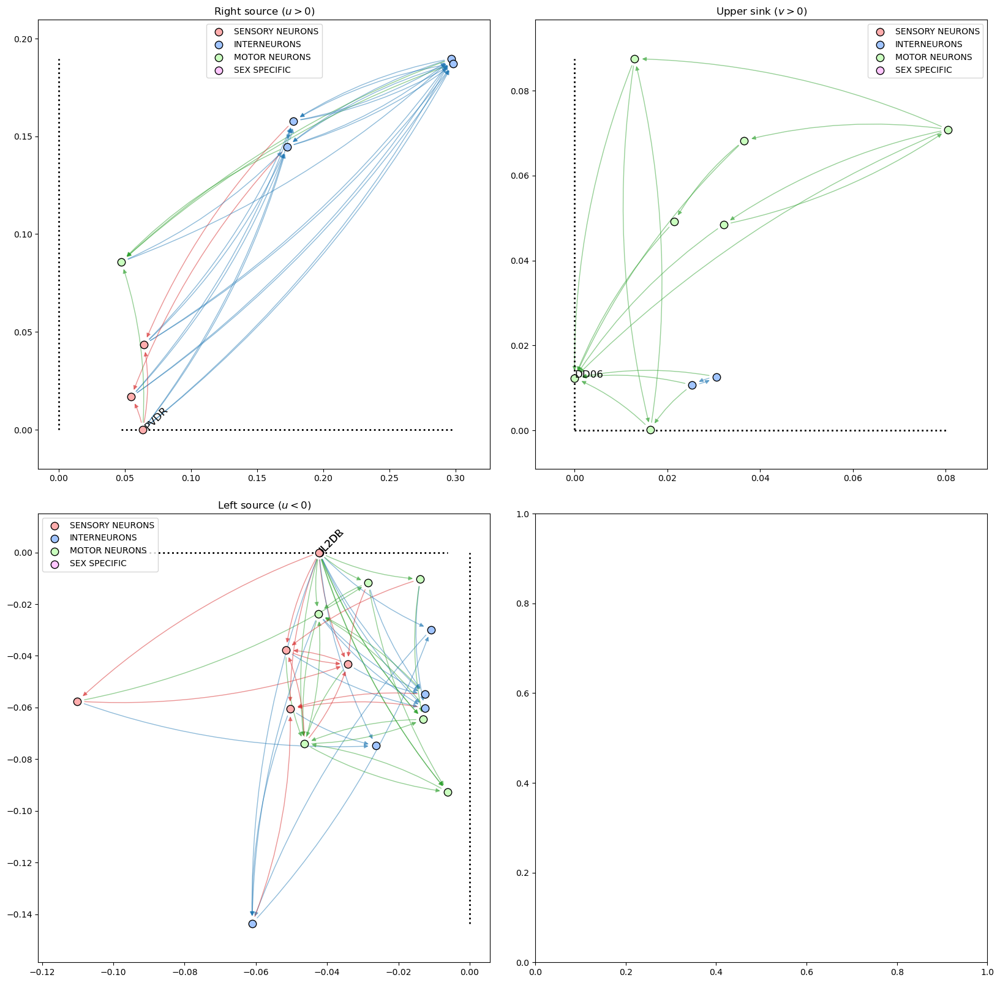

In [52]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 20),
                         #sharex="row", sharey="row",
                         gridspec_kw={"wspace":0.1, "hspace":0.1})

eig_id = np.where(S > 1e-10)[0][0]

zero_deg_thresh = 0
eig_thresh = 0
min_con = 3

titles = [f"Right source ($u>{eig_thresh}$)",
          f"Left source ($u<{eig_thresh}$)",
          f"Upper sink ($v>{eig_thresh}$)",
          f"Lower sink ($v<{eig_thresh}$)"]

for ax_i, ax_col in enumerate(axes.T):
    for ax_j, ax in enumerate(ax_col):

        wiring_red = wiring_sym.copy()
        if ax_j == 0:
            sink_source = np.logical_and(wiring_red.sum(axis=ax_i) <= zero_deg_thresh, [U, V][ax_i][:, eig_id] > eig_thresh, dtype=bool)
            sink_source = np.logical_and(sink_source, wiring_red.sum(axis=1-ax_i) > min_con, dtype=bool)
        else:
            sink_source = np.logical_and(wiring_red.sum(axis=ax_i) <= zero_deg_thresh, [U, V][ax_i][:, eig_id] < -eig_thresh, dtype=bool)
            sink_source = np.logical_and(sink_source, wiring_red.sum(axis=1-ax_i) > min_con, dtype=bool)

        mask = (wiring_red[sink_source].sum(axis=0) > 0) + (wiring_red[:, sink_source].sum(axis=1) > 0)
        mask = (mask + sink_source).astype(bool)

        wiring_red = wiring_red[mask][:, mask]
        labels_red = nodes_labels[mask]
        U_red = U[mask]
        V_red = V[mask]

        graph = nx.DiGraph(wiring_red)
        graph_pos = {i: (U_red[i, eig_id], V_red[i, eig_id]) for i in range(wiring_red.shape[0])}
        
        mycmap = plt.get_cmap("tab20")
        colors_edge = np.array(["tab:red", "tab:blue", "tab:green", "tab:gray"])
        colors = np.array(palette_rgb)

        edge_colors = np.zeros_like(np.array(graph.edges())[:, 0])

        for i, (_, target) in enumerate(graph.edges()):
            edge_colors[i] = neuron_def_df[neuron_def_df["Neuron"] == labels_red[target]]["Type_num"].values[0]
        #nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.1, ax=ax)
        nx.draw_networkx_edges(graph, pos=graph_pos, edge_color=colors_edge[edge_colors], alpha=.5, ax=ax, connectionstyle="arc3,rad=0.1")

        ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

        for i, n_type in enumerate(neuron_def_df["Type"].unique()):
            neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]

            type_mask = np.array([lab in neurons_in_type.values for lab in labels_red])
            ax.scatter(U_red[type_mask, eig_id], V_red[type_mask, eig_id], color=colors[i], s=80, label=n_type,
                       zorder=3, edgecolor="k", lw=1, alpha=1, marker=markers[1])

        label_filter = ["AVAL", "AVAR", "AVEL", "AVER", "RIAR", "RIAL"]
        #for i, neuron in enumerate(bullmore_label):
        for i, neuron in enumerate(labels_red):
            #if neuron in label_filter:
            #if True:
            if neuron in nodes_labels[sink_source]:
                ax.text(1.01*U_red[i, eig_id], 1.01*V_red[i, eig_id], neuron, fontsize=12, rotation=45*(1-ax_i))

        #x_max, y_max = np.max(np.vstack([U[:, eig_id], V[:, eig_id]]), axis=1)
        #x_min, y_min = np.min(np.vstack([U[:, eig_id], V[:, eig_id]]), axis=1)
        x_max, y_max = np.max(np.vstack([U_red[:, eig_id], V_red[:, eig_id]]), axis=1)
        x_min, y_min = np.min(np.vstack([U_red[:, eig_id], V_red[:, eig_id]]), axis=1)

        abs_min = max([x_min, y_min])
        abs_max = min([x_max, y_max])

        #axes.plot([abs_min, abs_max], [abs_min, abs_max], color="tab:orange")
        ax.plot([0, 0], [y_min, y_max], ls=":", lw=2, color="k")
        ax.plot([x_min, x_max], [0, 0], ls=":", lw=2, color="k")

        ax.legend()
        #ax.set_title(row_titles[ax_i] + " " + col_titles[ax_j])
        ax.set_title(titles[ax_i*2 + ax_j])
        #axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" {U[:, eig_id].T@V[:, eig_id]:1.2f}")

#ax.set_xlabel(f"{eig_id + 1}th Left Eigenvector ($U$)")
#ax.set_ylabel(f"{eig_id + 1}th Right Eigenvector ($V$)")

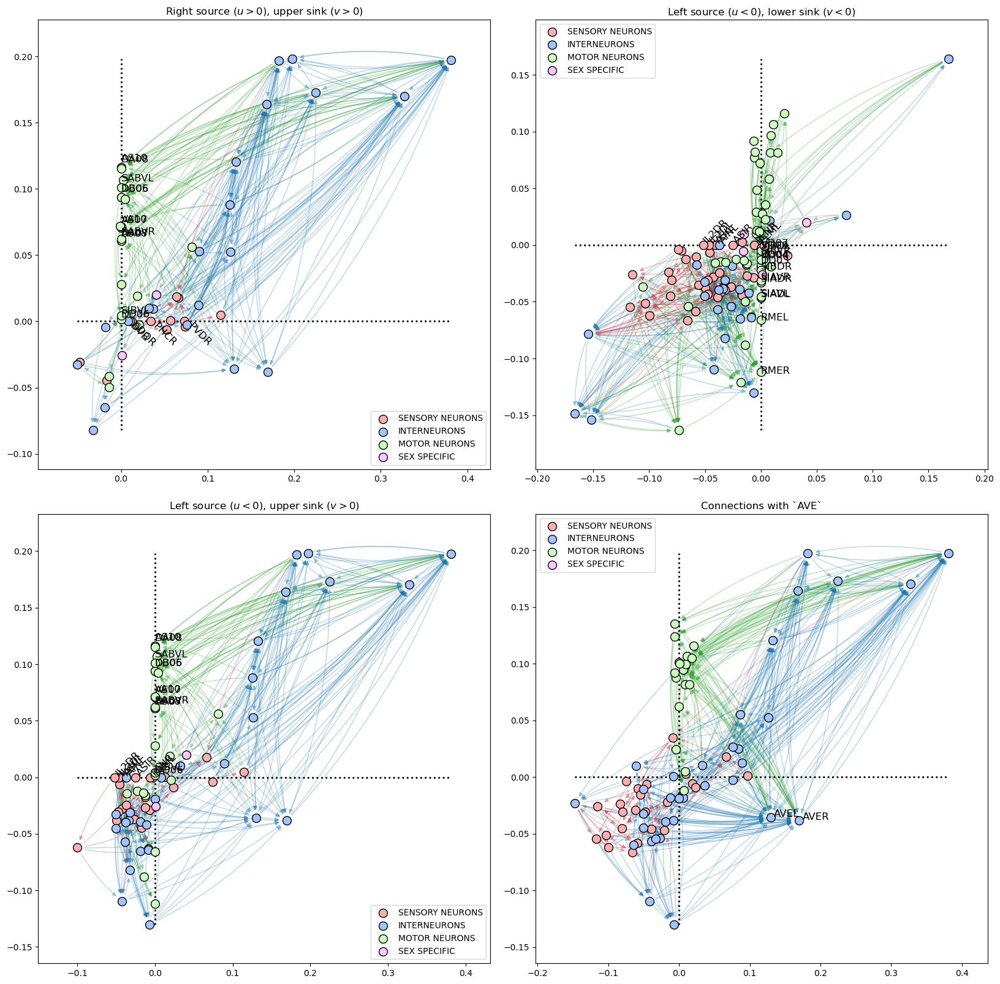

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 20),
                         #sharex=True, sharey=True,
                         gridspec_kw={"wspace":0.1, "hspace":0.1})

node_size = 100

show_overlap = False
eig_id = np.where(S > 1e-10)[0][0]

titles = ["Right source ($u>0$), upper sink ($v>0$)",
          "Left source ($u<0$), lower sink ($v<0$)",
          "Left source ($u<0$), upper sink ($v>0$)",
          #"Connections NOT WITH `AVE`",
          "Connections with `AVE`"]

zero_deg_thresh = 0
eig_thresh = 0

mask_list = []
for ax_i, ax in enumerate(axes.flatten()):

    wiring_red = wiring_sym.copy()

    invert_mask = False
    if ax_i == 0:
        sink = np.logical_and(wiring_red.sum(axis=1) <= zero_deg_thresh, V[:, eig_id] > eig_thresh, dtype=bool)
        source = np.logical_and(wiring_red.sum(axis=0) <= zero_deg_thresh, U[:, eig_id] > eig_thresh, dtype=bool)
    elif ax_i == 1:
        sink = np.logical_and(wiring_red.sum(axis=1) <= zero_deg_thresh, V[:, eig_id] < -eig_thresh, dtype=bool)
        source = np.logical_and(wiring_red.sum(axis=0) <= zero_deg_thresh, U[:, eig_id] < -eig_thresh, dtype=bool)
    elif ax_i == 2:
        sink = np.logical_and(wiring_red.sum(axis=1) <= zero_deg_thresh, V[:, eig_id] > eig_thresh, dtype=bool)
        source = np.logical_and(wiring_red.sum(axis=0) <= zero_deg_thresh, U[:, eig_id] < -eig_thresh, dtype=bool)
    #elif ax_i == 2:
    #    sink = np.array([lab in ["AVEL", "AVER"] for lab in nodes_labels])
    #    source = sink
    #    invert_mask = True
    else:
        sink = np.array([lab in ["AVEL", "AVER"] for lab in nodes_labels])
        source = sink

    sink_source = np.logical_or(sink, source, dtype=bool)

    mask = (wiring_red[sink_source].sum(axis=0) > 0) + (wiring_red[:, sink_source].sum(axis=1) > 0)
    mask = (mask + sink_source).astype(bool)

    if invert_mask:
        mask = ~mask

    mask_list.append(mask)

    wiring_red = wiring_red[mask][:, mask]
    labels_red = nodes_labels[mask]
    sink_red = sink[mask]
    source_red = source[mask]
    U_red = U[mask]
    V_red = V[mask]

    graph = nx.DiGraph(wiring_red)
    graph_pos = {i: (U_red[i, eig_id], V_red[i, eig_id]) for i in range(wiring_red.shape[0])}
    
    mycmap = plt.get_cmap("tab20")
    colors_edge = np.array(["tab:red", "tab:blue", "tab:green", "tab:gray"])
    colors = np.array(palette_rgb)

    edge_colors = np.zeros_like(np.array(graph.edges())[:, 0])

    for i, (_, target) in enumerate(graph.edges()):
        edge_colors[i] = neuron_def_df[neuron_def_df["Neuron"] == labels_red[target]]["Type_num"].values[0]
    #nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.1, ax=ax)
    nx.draw_networkx_edges(graph, pos=graph_pos, edge_color=colors_edge[edge_colors], alpha=.3, width=1, ax=ax, connectionstyle="arc3,rad=0.1")

    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

    for i, n_type in enumerate(neuron_def_df["Type"].unique()):
        neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]

        type_mask = np.array([lab in neurons_in_type.values for lab in labels_red])
        ax.scatter(U_red[type_mask, eig_id], V_red[type_mask, eig_id], color=colors[i], s=node_size, label=n_type,
                       zorder=3, edgecolor="k", lw=1, alpha=1, marker=markers[1])

    if not show_overlap:
        for i, neuron in enumerate(labels_red):
            if neuron in nodes_labels[sink_source]:
                rot = 45
                va = "bottom"
                if sink_red[i]:
                    rot = 0
                elif U_red[i, eig_id] > 0:
                    rot = -45
                    va = "top"
                ax.text(1.03*U_red[i, eig_id], 1.03*V_red[i, eig_id], neuron, fontsize=12, rotation=rot, va=va)

    x_max, y_max = np.max(np.vstack([U_red[:, eig_id], V_red[:, eig_id]]), axis=1)
    x_min, y_min = np.min(np.vstack([U_red[:, eig_id], V_red[:, eig_id]]), axis=1)

    abs_min = max([x_min, y_min])
    abs_max = min([x_max, y_max])

    ax.plot([0, 0], [y_min, y_max], ls=":", lw=2, color="k")
    ax.plot([x_min, x_max], [0, 0], ls=":", lw=2, color="k")

    ax.legend()
    ax.set_title(titles[ax_i])

#if show_overlap:
#    overlap = np.sum(mask_list, axis=0) == len(mask_list)
#    for node_id in np.where(overlap)[0]:
#        for ax in axes.flatten()[:-1]:
#            ax.scatter(U[node_id, eig_id], V[node_id, eig_id], color="none", s=node_size-10, edgecolor="tab:orange", lw=2, alpha=.5, zorder=4)
#            ax.text(1.03*U[node_id, eig_id], 1.03*V[node_id, eig_id], nodes_labels[node_id], fontsize=12)

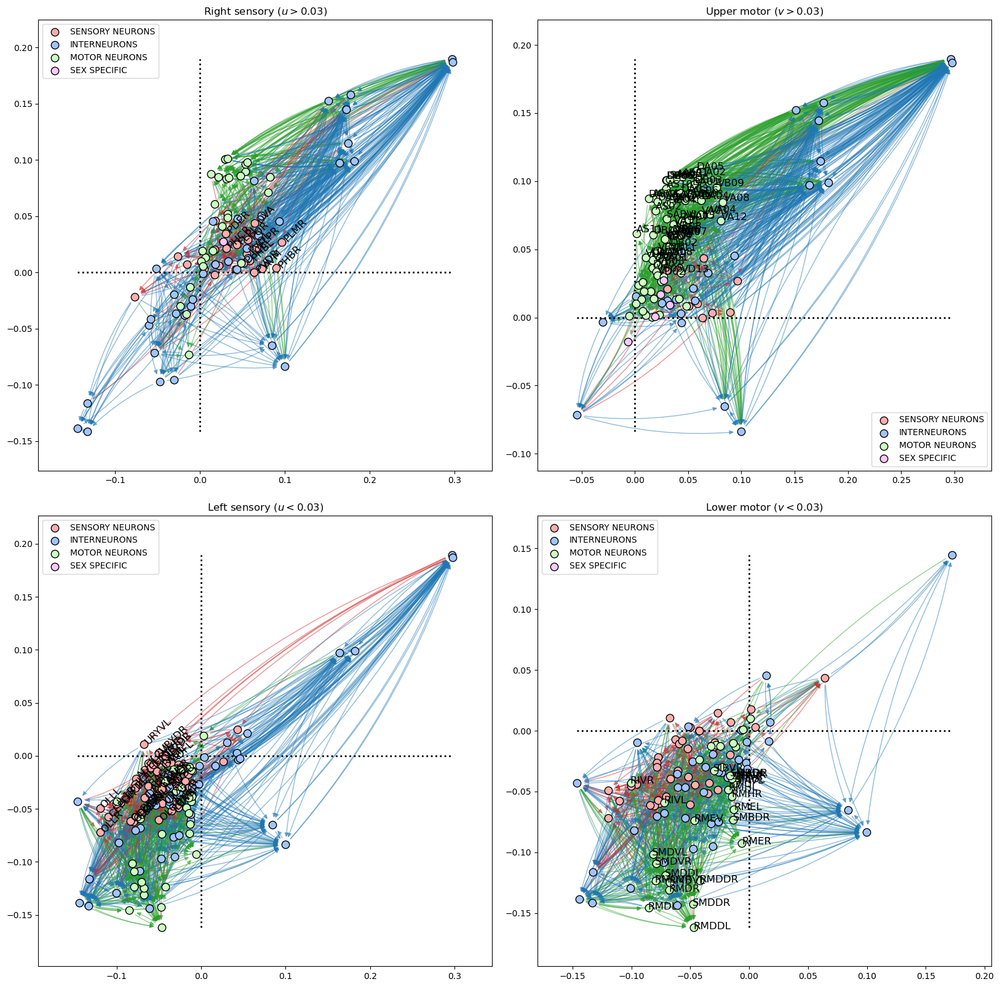

In [53]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 20),
                         #sharex="row", sharey="row",
                         gridspec_kw={"wspace":0.1, "hspace":0.1})

eig_id = np.where(S > 1e-10)[0][0]

zero_deg_thresh = 0
eig_thresh = 0.03

titles = [f"Right sensory ($u>{eig_thresh}$)",
          f"Left sensory ($u<{eig_thresh}$)",
          f"Upper motor ($v>{eig_thresh}$)",
          f"Lower motor ($v<{eig_thresh}$)"]

type_neuron = [0, 2]
for ax_i, ax_col in enumerate(axes.T):
    for ax_j, ax in enumerate(ax_col):

        wiring_red = wiring_sym.copy()
        if ax_j == 0:
            sink_source = np.logical_and([n == type_neuron[ax_i] for n in bullmore_type_num], [U, V][ax_i][:, eig_id] > eig_thresh, dtype=bool)
        else:
            sink_source = np.logical_and([n == type_neuron[ax_i] for n in bullmore_type_num], [U, V][ax_i][:, eig_id] < -eig_thresh, dtype=bool)

        if ax_i == 0:
            mask = wiring_sym[sink_source].sum(axis=ax_i) > 0
        else:
            mask = wiring_sym[:, sink_source].sum(axis=ax_i) > 0
        #mask = (wiring_red[sink_source].sum(axis=0) > 0) + (wiring_red[:, sink_source].sum(axis=1) > 0)
        mask = (mask + sink_source).astype(bool)

        wiring_red = wiring_red[mask][:, mask]
        labels_red = nodes_labels[mask]
        U_red = U[mask]
        V_red = V[mask]

        graph = nx.DiGraph(wiring_red)
        graph_pos = {i: (U_red[i, eig_id], V_red[i, eig_id]) for i in range(wiring_red.shape[0])}
        
        colors_edge = np.array(["tab:red", "tab:blue", "tab:green", "tab:gray"])
        colors = np.array(palette_rgb)

        edge_colors = np.zeros_like(np.array(graph.edges())[:, 0])

        for i, (_, target) in enumerate(graph.edges()):
            edge_colors[i] = neuron_def_df[neuron_def_df["Neuron"] == labels_red[target]]["Type_num"].values[0]
        #nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.1, ax=ax)
        nx.draw_networkx_edges(graph, pos=graph_pos, edge_color=colors_edge[edge_colors], alpha=.5, ax=ax, connectionstyle="arc3,rad=0.1")

        ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

        for i, n_type in enumerate(neuron_def_df["Type"].unique()):
            neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]

            type_mask = np.array([lab in neurons_in_type.values for lab in labels_red])
            ax.scatter(U_red[type_mask, eig_id], V_red[type_mask, eig_id], color=colors[i], s=80, label=n_type,
                       zorder=3, edgecolor="k", lw=1, alpha=1, marker=markers[1])

        label_filter = ["AVAL", "AVAR", "AVEL", "AVER", "RIAR", "RIAL"]
        #for i, neuron in enumerate(bullmore_label):
        for i, neuron in enumerate(labels_red):
            #if neuron in label_filter:
            #if True:
            if neuron in nodes_labels[sink_source]:
                ax.text(1.01*U_red[i, eig_id], 1.01*V_red[i, eig_id], neuron, fontsize=12, rotation=45*(1-ax_i))

        #x_max, y_max = np.max(np.vstack([U[:, eig_id], V[:, eig_id]]), axis=1)
        #x_min, y_min = np.min(np.vstack([U[:, eig_id], V[:, eig_id]]), axis=1)
        x_max, y_max = np.max(np.vstack([U_red[:, eig_id], V_red[:, eig_id]]), axis=1)
        x_min, y_min = np.min(np.vstack([U_red[:, eig_id], V_red[:, eig_id]]), axis=1)

        abs_min = max([x_min, y_min])
        abs_max = min([x_max, y_max])

        #axes.plot([abs_min, abs_max], [abs_min, abs_max], color="tab:orange")
        ax.plot([0, 0], [y_min, y_max], ls=":", lw=2, color="k")
        ax.plot([x_min, x_max], [0, 0], ls=":", lw=2, color="k")

        ax.legend()
        #ax.set_title(row_titles[ax_i] + " " + col_titles[ax_j])
        ax.set_title(titles[ax_i*2 + ax_j])
        #axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" {U[:, eig_id].T@V[:, eig_id]:1.2f}")

#ax.set_xlabel(f"{eig_id + 1}th Left Eigenvector ($U$)")
#ax.set_ylabel(f"{eig_id + 1}th Right Eigenvector ($V$)")

## Bipartite idea

{'SENSORY NEURONS': 0, 'INTERNEURONS': 1, 'MOTOR NEURONS': 2, 'SEX SPECIFIC': 3}


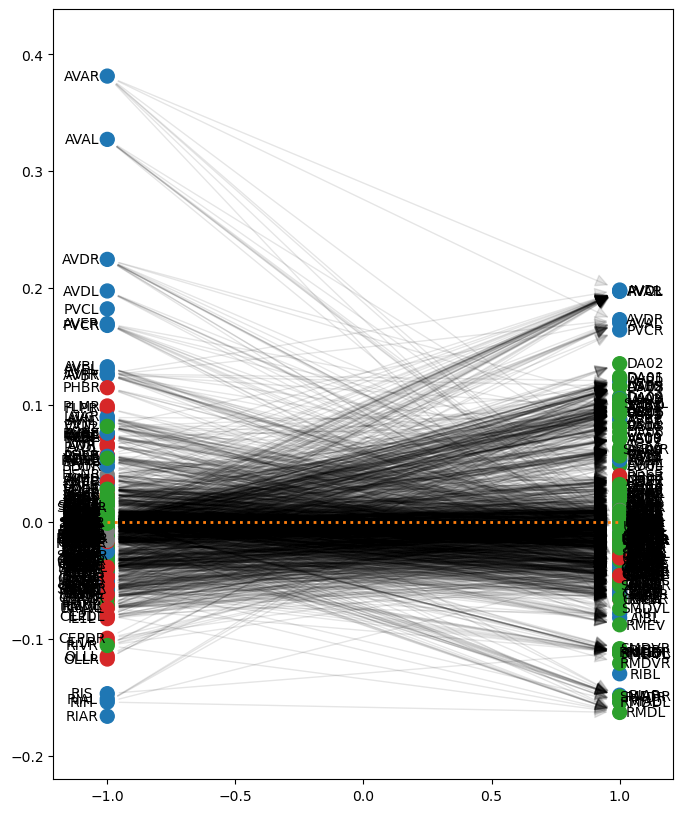

In [31]:
importlib.reload(dgsp_plot)

type_dict = {t: i for i, t in enumerate(neuron_def_df["Type"].unique())}

print(type_dict)

clusters = np.array([type_dict[neuron_def_df[neuron_def_df.Neuron == lab]["Type"].values[0]] for lab in bullmore_label])

dgsp_plot.plot_bipartite_SVD(wiring_sym, U, Vh, vector_id=0, clusters=clusters, node_size=100, edge_alpha=.1,
                             colors=["tab:red", "tab:blue", "tab:green", "tab:gray"],
                             labels=bullmore_label)

plt.plot([-1, 1], [0]*2, lw=2, ls=":", color="tab:orange")

#plt.axis([-1.5, 1.5, -0.2, 0.15])

{'SENSORY NEURONS': 0, 'INTERNEURONS': 1, 'MOTOR NEURONS': 2, 'SEX SPECIFIC': 3}


/Users/acionca/code/dGSP/dSVD/plotting.py:94: UserWarning:



The connectionstyle keyword argument is not applicable when drawing edges
with LineCollection.

To make this warning go away, either specify `arrows=True` to
force FancyArrowPatches or use the default value for connectionstyle.
Note that using FancyArrowPatches may be slow for large graphs.




(<Figure size 3000x800 with 1 Axes>, None)

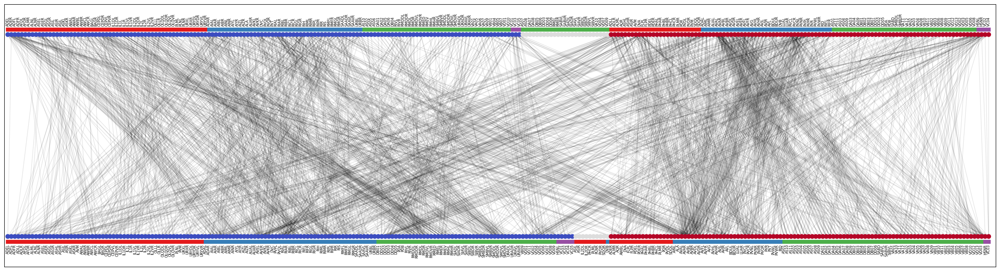

In [208]:
importlib.reload(dgsp_plot)

type_dict = {t: i for i, t in enumerate(neuron_def_df["Type"].unique())}

print(type_dict)

clusters = np.array([type_dict[neuron_def_df[neuron_def_df.Neuron == lab]["Type"].values[0]] for lab in nodes_labels])

dgsp_plot.plot_cluster_bipartite(wiring_sym, U, Vh, clusters=clusters, vector_id=0, node_size=50, edge_alpha=.1,
                                 colors=["tab:red", "tab:blue", "tab:green", "tab:gray"], labels=nodes_labels)

#plt.axis([-1.5, 1.5, -0.2, 0.15])

## Looking at cluster subset

Zero mask has 0 elements
Zero mask has 134 elements
Zero mask has 91 elements


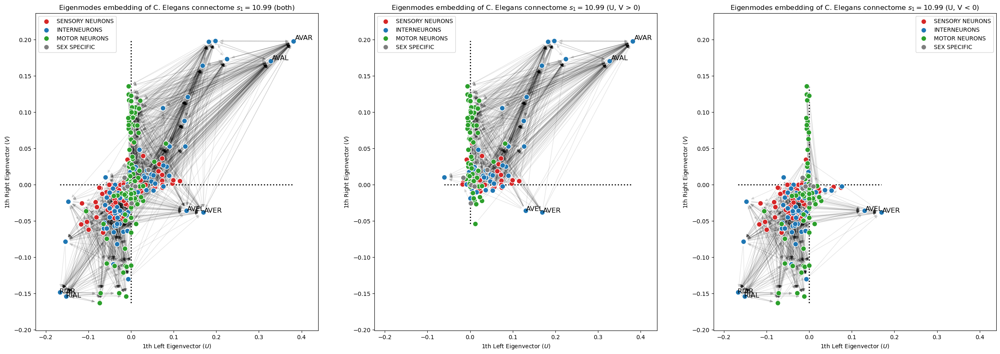

In [33]:
fig, axes = plt.subplots(ncols=3, figsize=(30, 10), sharex=True, sharey=True)

eig_id = np.where(S > 1e-10)[0][0]

label_filter = ["AVAL", "AVAR", "AVEL", "AVER", "RIAR", "RIAL"]
#label_filter = ["AVEL", "AVER"]

for ax_i, ax in enumerate(axes):

    connected_U_mask = np.ones_like(bullmore_label, dtype=bool)
    connected_V_mask = np.ones_like(bullmore_label, dtype=bool)
    if ax_i > 0:
        sign_val = 1 if ax_i == 1 else -1
        connected_U_mask = np.sign(U[:, eig_id]) == sign_val
        connected_V_mask = np.sign(V[:, eig_id]) == sign_val

    wiring_masked = wiring_sym.copy()
    wiring_masked[~connected_U_mask] = 0
    wiring_masked[:, ~connected_V_mask] = 0

    zero_mask = np.logical_and(wiring_masked.sum(axis=1) == 0, wiring_masked.sum(axis=0) == 0)
    print(f"Zero mask has {zero_mask.sum()} elements")

    wiring_masked = wiring_masked[~zero_mask][:, ~zero_mask]
    
    U_masked = U[~zero_mask]
    V_masked = V[~zero_mask]
    label_masked = bullmore_label[~zero_mask]

    graph = nx.DiGraph(wiring_masked)
    #graph = nx.Graph(wiring_masked)
    graph_pos = {i: (U_masked[i, eig_id], V_masked[i, eig_id]) for i in range(wiring_masked.shape[0])}
    #nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.05)
    nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.1, ax=ax)


    #mycmap = plt.get_cmap("tab10")
    colors = ["tab:red", "tab:blue", "tab:green", "tab:gray"]

    for i, n_type in enumerate(neuron_def_df["Type"].unique()):
        neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]

        type_mask = np.array([lab in neurons_in_type.values for lab in label_masked])
        ax.scatter(U_masked[type_mask, eig_id], V_masked[type_mask, eig_id], color=colors[i], s=80, label=n_type,
                    zorder=3, edgecolor="w", lw=1)

    for i, neuron in enumerate(label_masked):
        if neuron in label_filter:
        #if True:
            ax.text(1.01*U_masked[i, eig_id], 1.01*V_masked[i, eig_id], neuron, fontsize=12)

    x_max, y_max = np.max(np.vstack([U_masked[:, eig_id], V_masked[:, eig_id]]), axis=1)
    x_min, y_min = np.min(np.vstack([U_masked[:, eig_id], V_masked[:, eig_id]]), axis=1)

    abs_min = max([x_min, y_min])
    abs_max = min([x_max, y_max])

    #axes.plot([abs_min, abs_max], [abs_min, abs_max], color="tab:orange")
    ax.plot([0, 0], [y_min, y_max], ls=":", lw=2, color="k")
    ax.plot([x_min, x_max], [0, 0], ls=":", lw=2, color="k")

    ax.legend()
    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.set_xlabel(f"{eig_id + 1}th Left Eigenvector ($U$)")
    ax.set_ylabel(f"{eig_id + 1}th Right Eigenvector ($V$)")
    ax.set_title("Eigenmodes embedding of C. Elegans connectome" + f" $s_{eig_id+1}={S[eig_id]:1.2f}$" + f" ({['both', 'U, V > 0', 'U, V < 0'][ax_i]})")
    #ax.set_title("Eigenmodes embedding of C. Elegans connectome" + f" s={S[eig_id]:1.2f}" + f" (Focus on {' '.join(label_filter)}")# {['both', 'out', 'in'][i]})")
    #axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" {U[:, eig_id].T@V[:, eig_id]:1.2f}")

## Left or Right eigenvector embedding

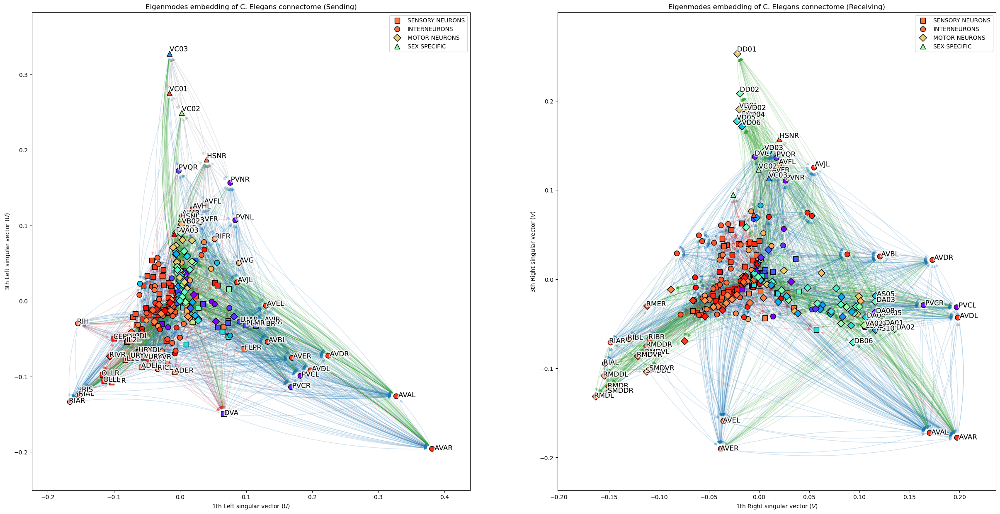

In [9]:
from matplotlib.patheffects import withStroke

fig, axes = plt.subplots(ncols=2, figsize=(30, 15))

eig_id = np.where(S > 1e-10)[0][0]
second_id = 2
rad_perc = 20

x_pos = bullmore_pos[:, 0]
y_pos = bullmore_pos[:, 1]

eig_name = ["U", "V"]
side = ["Left", "Right"]
for ax_i, (ax, eigenvector) in enumerate(zip(axes, [U, V])):

    graph = nx.DiGraph(wiring_sym)
    graph_pos = {i: (eigenvector[i, eig_id], eigenvector[i, eig_id+second_id]) for i in range(wiring_sym.shape[0])}
    
    mycmap = plt.get_cmap("tab20")
    colors_edge = np.array(["tab:red", "tab:blue", "tab:green", "tab:gray"])
    colors = np.array(palette_rgb)

    edge_colors = np.zeros_like(np.array(graph.edges())[:, 0])

    for i, (_, target) in enumerate(graph.edges()):
        edge_colors[i] = neuron_def_df[neuron_def_df["Neuron"] == bullmore_label[target]]["Type_num"].values[0]
    #nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.1, ax=ax)
    nx.draw_networkx_edges(graph, pos=graph_pos, edge_color=colors_edge[edge_colors], alpha=.2, width=1, ax=ax, connectionstyle="arc3,rad=0.1")

    markers = ["s", "o", "D", "^"]
    for i, n_type in enumerate(neuron_def_df["Type"].unique()):
        neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]
    # for i, n_type in enumerate(neuron_def_df["Type_long"].unique()):
    #     neurons_in_type = neuron_def_df.loc[neuron_def_df["Type_long"] == n_type, "Neuron"]

        #type_mask = np.array([lab in neurons_in_type.values for lab in bullmore_label])
        type_mask = np.array([lab in neurons_in_type.values for lab in nodes_labels])
        #ax.scatter(eigenvector[type_mask, eig_id], eigenvector[type_mask, eig_id+second_id], color=colors[i], s=80, label=n_type,
        avg_pos = x_pos - np.sign(x_pos + 0.5) * y_pos * 5
        ax.scatter(eigenvector[type_mask, eig_id], eigenvector[type_mask, eig_id+second_id], c=avg_pos[type_mask], cmap="rainbow", s=80, label=n_type,
                    zorder=3, edgecolor="k", marker=markers[i], lw=1)
        #ax.scatter(eigenvector[type_mask, eig_id], eigenvector[type_mask, eig_id+2], color=mycmap(i), s=80, label=n_type,
        #         zorder=3, edgecolor="w", lw=1)

    label_filter = ["AVAL", "AVAR", "AVEL", "AVER", "RIAR", "RIAL"]
    #for i, neuron in enumerate(bullmore_label):


    radius = eigenvector[:, eig_id]**2 + eigenvector[:, eig_id+second_id]**2
    for i, neuron in enumerate(nodes_labels):
        #if neuron in label_filter:
        #if True:
        if radius[i] > np.percentile(radius, 100 - rad_perc):
            ax.text(1.01*eigenvector[i, eig_id], 1.01*eigenvector[i, eig_id+second_id],
                    neuron, fontsize=12, 
                    path_effects=[withStroke(linewidth=4, foreground="w", alpha=0.8)])

    ax.legend()
    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.set_xlabel(f"{eig_id + 1}th {side[ax_i]} singular vector (${eig_name[ax_i]}$)")
    ax.set_ylabel(f"{eig_id + 1 + second_id}th {side[ax_i]} singular vector (${eig_name[ax_i]}$)")
    ax.set_title(f"Eigenmodes embedding of C. Elegans connectome ({['Sending', 'Receiving'][ax_i]})")
#axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" {U[:, eig_id].T@V[:, eig_id]:1.2f}")

fig.savefig("eigenvectors_embedding.png", dpi=300, bbox_inches="tight")

(-0.22456990991999204, 0.37086127575896977)

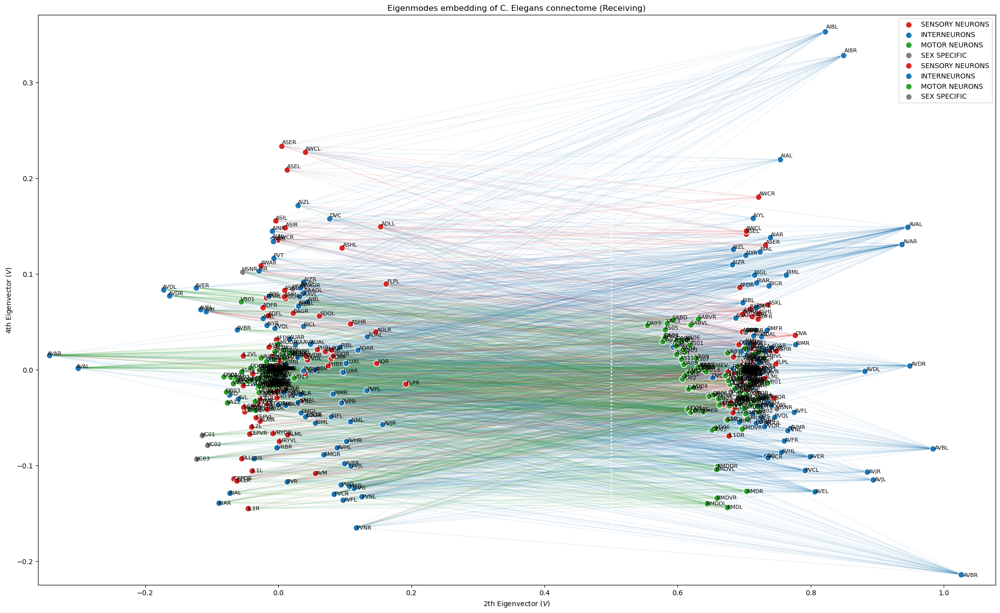

In [41]:
fig, ax = plt.subplots(figsize=(25, 15))

eig_id = np.where(S > 1e-10)[0][0]+1
second_id = 2
x_scale = 0.7

eig_name = ["U", "V"]
graph_pos = {}
for ax_i, eigenvector in enumerate([U, V]):

    graph_pos.update({i + ax_i * wiring_sym.shape[0]: (x_scale*ax_i + eigenvector[i, eig_id], eigenvector[i, eig_id+second_id]) for i in range(wiring_sym.shape[0])})

    mycmap = plt.get_cmap("tab20")
    colors = ["tab:red", "tab:blue", "tab:green", "tab:gray"]

    for i, n_type in enumerate(neuron_def_df["Type"].unique()):
        neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]
    # for i, n_type in enumerate(neuron_def_df["Type_long"].unique()):
    #     neurons_in_type = neuron_def_df.loc[neuron_def_df["Type_long"] == n_type, "Neuron"]

        type_mask = np.array([lab in neurons_in_type.values for lab in bullmore_label])
        #type_mask = np.array([lab in neurons_in_type.values for lab in neuron_def_df.Neuron])
        ax.scatter(x_scale*ax_i + eigenvector[type_mask, eig_id], eigenvector[type_mask, eig_id+second_id], color=colors[i], s=80, label=n_type,
                    zorder=3, edgecolor="w", lw=1)
        #ax.scatter(eigenvector[type_mask, eig_id], eigenvector[type_mask, eig_id+2], color=mycmap(i), s=80, label=n_type,
        #         zorder=3, edgecolor="w", lw=1)

    label_filter = ["AVAL", "AVAR", "AVEL", "AVER", "RIAR", "RIAL"]
    for i, neuron in enumerate(bullmore_label):
    #for i, neuron in enumerate(neuron_def_df.Neuron):
        #if neuron in label_filter:
        if True:
            ax.text(x_scale*ax_i + 1.01*eigenvector[i, eig_id], 1.01*eigenvector[i, eig_id+second_id], neuron, fontsize=8)

    ax.legend()
    ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
    ax.set_xlabel(f"{eig_id + 1}th Eigenvector (${eig_name[ax_i]}$)")
    ax.set_ylabel(f"{eig_id + 1 + second_id}th Eigenvector (${eig_name[ax_i]}$)")
    ax.set_title(f"Eigenmodes embedding of C. Elegans connectome ({['Sending', 'Receiving'][ax_i]})")

ax.plot([0.5]*2, [-.2, .2], lw=2, ls=":", color="w")
wiring_bip = np.concatenate([np.zeros_like(wiring_sym), wiring_sym], axis=1)
wiring_bip = np.concatenate([wiring_bip, np.zeros_like(wiring_bip)])

graph = nx.DiGraph(wiring_bip)

colors_edge = np.array(["tab:red", "tab:blue", "tab:green", "tab:gray"])
#colors = np.array(palette_rgb)

edge_colors = np.zeros_like(np.array(graph.edges())[:, 0])

for i, (_, target) in enumerate(graph.edges()):
    if target >= wiring_sym.shape[0]:
        target -= wiring_sym.shape[0]
    edge_colors[i] = neuron_def_df[neuron_def_df["Neuron"] == bullmore_label[target]]["Type_num"].values[0]

arc = False
if arc:
    _ = nx.draw_networkx_edges(graph, pos=graph_pos, edge_color=colors_edge[edge_colors], alpha=.1, width=1, ax=ax, connectionstyle="arc3,rad=0.1")
else:
    graph = nx.Graph(wiring_bip)
    _ = nx.draw_networkx_edges(graph, pos=graph_pos, edge_color=colors_edge[edge_colors], alpha=.1, width=1, ax=ax)

ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
#ax.set_xlim(-.2, 1.23)
minx = np.array(list(graph_pos.values()))[:, 0].min()
miny = np.array(list(graph_pos.values()))[:, 1].min()
maxy = np.array(list(graph_pos.values()))[:, 1].max()

ax.set_xlim(minx*1.05, 1.05*(x_scale + V[:, eig_id].max()))
#ax.set_ylim(-.5, .5)
ax.set_ylim(miny*1.05, maxy*1.05)
#axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" {U[:, eig_id].T@V[:, eig_id]:1.2f}")

In [36]:
eig_id = np.where(S > 1e-10)[0][0]

label_filter = ["AVAL", "AVAR", "AVEL", "AVER"]#, "RIAR", "RIAL"]
#label_filter = ["AVEL", "AVER"]
roi_ids = np.where([lab in label_filter for lab in bullmore_label])[0]

connected_mask = (wiring_sym[roi_ids].sum(axis=0) + wiring_sym[:, roi_ids].sum(axis=1)) > 0
connected_mask[roi_ids] = True

wiring_masked = wiring_sym[connected_mask][:, connected_mask]
U_masked = U[connected_mask]
V_masked = V[connected_mask]
label_masked = bullmore_label[connected_mask]

## Macaque

,Node,Area,Name,x,y,z,Volume (mm^3),Module,Categories,Reference for spatial information,Online Resource
0,1,Hyp,Hypthalamus,1.09,-6.75,9.78,100,3,R3,“The Rhesus Monkey Brain in Stereotaxic Coordi...,https://scalablebrainatlas.incf.org/macaque/PHT00
1,2,LD#1,Laterodorsal nucleus,4.30,-12.15,20.80,12,5,R3,“The Rhesus Monkey Brain in Stereotaxic Coordi...,https://scalablebrainatlas.incf.org/macaque/PHT00
2,3,AV,Nucleus anterior ventralis thalami,2.83,-9.00,20.15,9,2,R3,“The Rhesus Monkey Brain in Stereotaxic Coordi...,https://scalablebrainatlas.incf.org/macaque/PHT00
3,4,AM#1,Nucleus anterior medialis thalami,1.76,-9.00,18.62,4,1,R2,“The Rhesus Monkey Brain in Stereotaxic Coordi...,https://scalablebrainatlas.incf.org/macaque/PHT00
4,5,AD#1,Nucleus anterior dorsalis thalami,2.93,-10.35,20.37,2,1,R2,“The Rhesus Monkey Brain in Stereotaxic Coordi...,https://scalablebrainatlas.incf.org/macaque/PHT00
...,...,...,...,...,...,...,...,...,...,...,...
239,261,Cd_g,Nucleus caudatus; genu,5.00,-0.90,21.90,520,5,R3,“The Rhesus Monkey Brain in Stereotaxic Coordi...,https://scalablebrainatlas.incf.org/macaque/PHT00
240,263,Pu_c,Putamen; caudal,14.87,-8.10,16.44,500,2,R2,“The Rhesus Monkey Brain in Stereotaxic Coordi...,https://scalablebrainatlas.incf.org/macaque/PHT00
241,264,Clau,Claustrum,15.52,-2.50,22.00,30,2,R3,J Comp Neurol. 2000 May 22;421(1):52-79.,https://www.ncbi.nlm.nih.gov/pubmed/10813772
242,265,MB#2,Mid Brain,5.00,-16.20,6.40,150,5,R2,Am J Med Technol. 1975 Dec;41(12):457-62.,https://www.ncbi.nlm.nih.gov/pubmed/2010


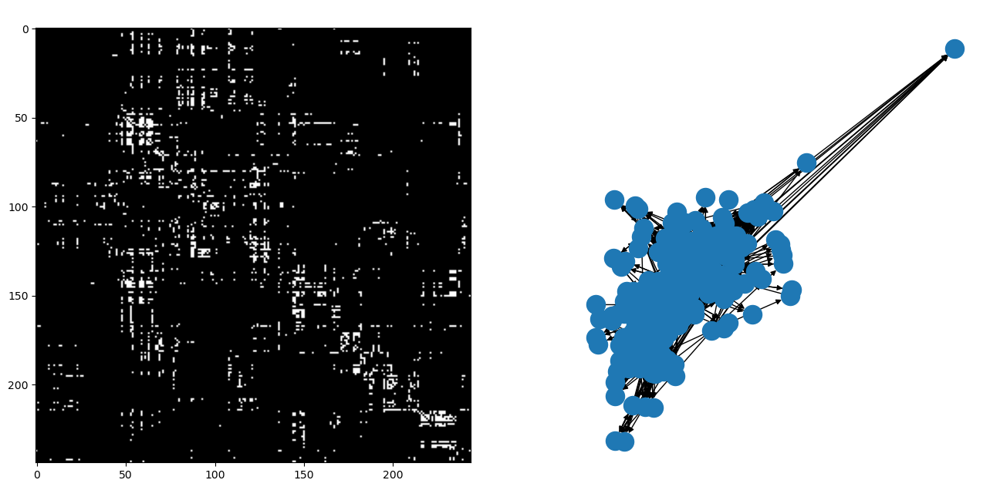

In [6]:
macaque_nodes = pd.read_excel("data/macaque/connectome_nodes.xls", header=1)
macaque_edges = pd.read_excel("data/macaque/connectome_links.xls", header=None)

macaque_adj = np.zeros((macaque_nodes.shape[0], macaque_nodes.shape[0]))

for i, row in macaque_edges.iterrows():
    macaque_adj[row[0]-1, row[1]-1] = 1

zero_mask = (macaque_adj.sum(axis=1) == 0) + (macaque_adj.sum(axis=0) == 0)

macaque_adj = macaque_adj[~zero_mask][:, ~zero_mask]
macaque_nodes = macaque_nodes.loc[~zero_mask].reset_index(drop=True)

fig, axes = plt.subplots(ncols=2, figsize=(16, 8))
axes[0].imshow(macaque_adj, cmap="binary_r")

nx.draw(nx.DiGraph(macaque_adj), ax=axes[1])

macaque_nodes

mean of V^T U: 0.14063333519448754


Text(0.5, 1.0, 'Eigenvectors (2 smallest non zero)')

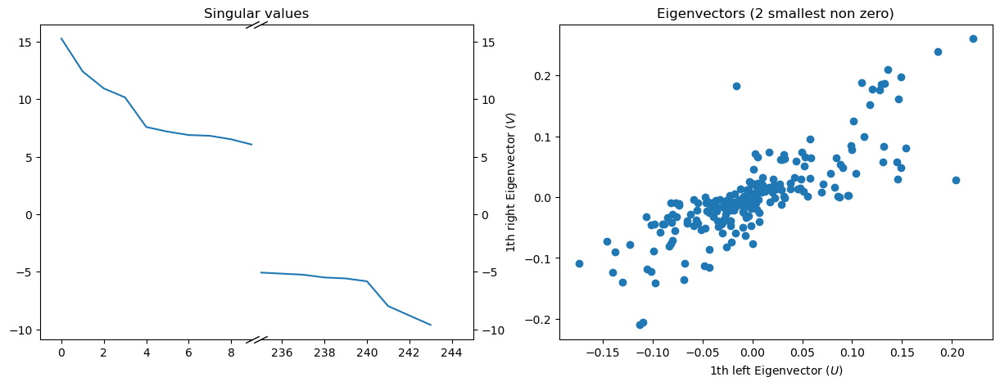

In [7]:
macaque_mod = dgsp.modularity_matrix(macaque_adj, null_model="outin")

d_mat = np.diag(macaque_mod.sum(axis=1))

U, S, Vh = dgsp.sorted_SVD(macaque_mod, fix_negative=True)
V = Vh.T

print("mean of V^T U:", np.diag(Vh@U).mean())

sort_idx = np.flip(np.argsort(S))
S = S[sort_idx]
U = U[:, sort_idx]
V = V[:, sort_idx]

show_n_eig = 9
# Plotting the singular values
#fig = plt.figure(figsize=(15, 5))
#gs = GridSpec(1, 2, wspace=0.25)

fig, all_axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))

gs1 = GridSpecFromSubplotSpec(1, 2, subplot_spec=all_axes[0], wspace=.04)

axes = [fig.add_subplot(gs1[0]), fig.add_subplot(gs1[1]), fig.add_subplot(all_axes[1])]

# Clear the 1st subplot (in the background)
all_axes[0].set_title("Singular values")
all_axes[0].set_xticks([])
all_axes[0].set_yticks([])
for loc, s in all_axes[0].spines.items():
    s.set_visible(False)

axes[0].plot(S)
axes[1].plot(S)

axes[0].set_xlim(-1, show_n_eig)
axes[1].set_xlim(len(S)-show_n_eig, len(S)+1)

axes[0].spines.right.set_visible(False)
axes[1].spines.left.set_visible(False)

axes[1].yaxis.tick_right()

# From matplotlib examples
d = .5  # proportion of vertical to horizontal extent of the slanted line
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
axes[0].plot([1, 1], [1, 0], transform=axes[0].transAxes, **kwargs)
axes[1].plot([0, 0], [0, 1], transform=axes[1].transAxes, **kwargs)

eig_id = np.where(S > 1e-5)[0][0]

axes[2].scatter(U[:, eig_id], V[:, eig_id])
axes[2].set_xlabel(f"{eig_id + 1}th left Eigenvector ($U$)")
axes[2].set_ylabel(f"{eig_id + 1}th right Eigenvector ($V$)")
axes[2].set_title("Eigenvectors (2 smallest non zero)")

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Text(0.5, 1.0, 'Eigenmodes embedding of C. Elegans connectome s=15.27')

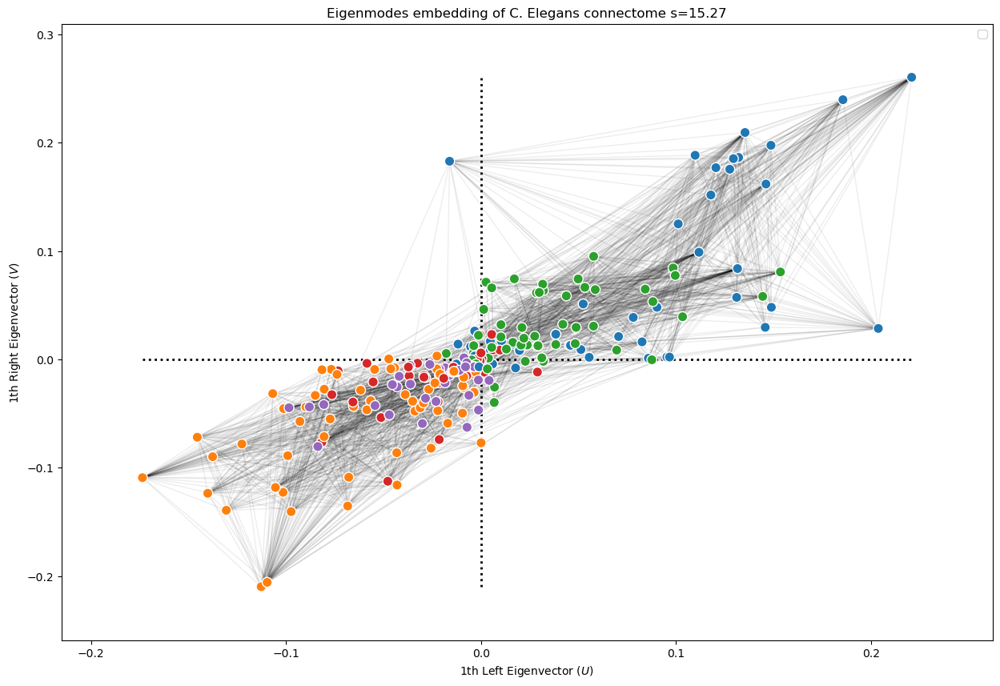

In [43]:
fig, axes = plt.subplots(figsize=(15, 10))

eig_id = np.where(S > 1e-10)[0][0]

graph = nx.Graph(macaque_adj)
graph_pos = {i: (U[i, eig_id], V[i, eig_id]) for i in range(macaque_mod.shape[0])}
#nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.05)
nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.07)

axes.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

mycmap = plt.get_cmap("tab20")
colors = ["tab:red", "tab:blue", "tab:green", "tab:gray"]

#for i, n_type in enumerate(neuron_def_df["Type"].unique()):
#    neurons_in_type = neuron_def_df.loc[neuron_def_df["Type"] == n_type, "Neuron"]
#
#    #type_mask = np.array([lab in neurons_in_type.values for lab in bullmore_label])
#    type_mask = np.array([lab in neurons_in_type.values for lab in nodes_labels])
#    axes.scatter(U[type_mask, eig_id], V[type_mask, eig_id], color=colors[i], s=80, label=n_type,
#                 zorder=3, edgecolor="w", lw=1, alpha=.8)

#axes.scatter(U[:, eig_id], V[:, eig_id], color="tab:blue", s=80, zorder=3, edgecolor="w", lw=1)
axes.scatter(U[:, eig_id], V[:, eig_id], c=macaque_nodes.loc[:, "Module"], cmap="tab10", vmax=10, s=80, zorder=3, edgecolor="w", lw=1)

#label_filter = ["AVAL", "AVAR", "AVEL", "AVER", "RIAR", "RIAL"]
#for i, neuron in enumerate(macaque_nodes.Name):
#    #if neuron in label_filter:
#    if True:
#        axes.text(1.01*U[i, eig_id], 1.01*V[i, eig_id], neuron, fontsize=12)

x_max, y_max = np.max(np.vstack([U[:, eig_id], V[:, eig_id]]), axis=1)
x_min, y_min = np.min(np.vstack([U[:, eig_id], V[:, eig_id]]), axis=1)

abs_min = max([x_min, y_min])
abs_max = min([x_max, y_max])

#axes.plot([abs_min, abs_max], [abs_min, abs_max], color="tab:orange")
axes.plot([0, 0], [y_min, y_max], ls=":", lw=2, color="k")
axes.plot([x_min, x_max], [0, 0], ls=":", lw=2, color="k")

axes.legend()
axes.set_xlabel(f"{eig_id + 1}th Left Eigenvector ($U$)")
axes.set_ylabel(f"{eig_id + 1}th Right Eigenvector ($V$)")
axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" s={S[eig_id]:1.2f}")
#axes.set_title("Eigenmodes embedding of C. Elegans connectome" + f" {U[:, eig_id].T@V[:, eig_id]:1.2f}")

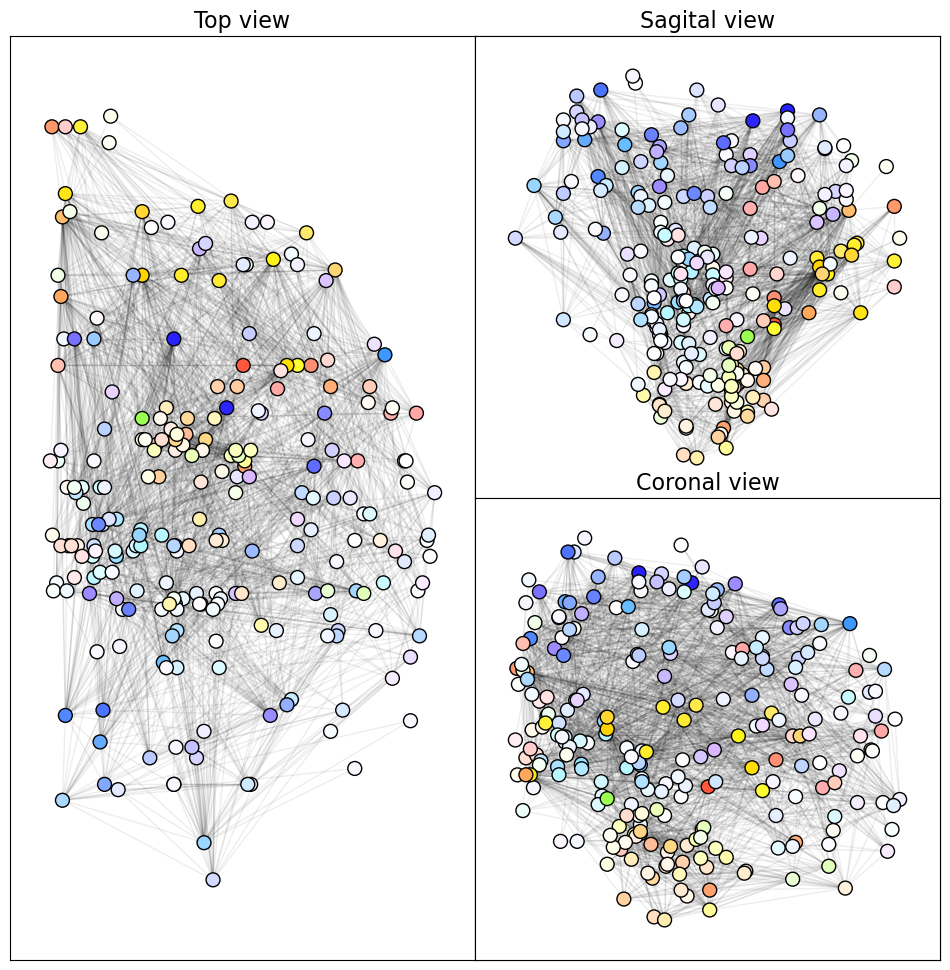

In [58]:
from matplotlib.colors import hsv_to_rgb

angles = np.arctan2(U[:, eig_id], V[:, eig_id])
angles = np.arctan2(V[:, eig_id], U[:, eig_id])

angles_prop = angles/(2*np.pi)
angles_prop[angles_prop < 0] = 1+angles_prop[angles_prop < 0]

angle_offset = 0
angles_prop += angle_offset

percent_radius = 0.8
radius = np.sqrt(U[:, eig_id]**2 + V[:, eig_id]**2)
radius = np.clip(radius/(radius.max()*percent_radius), a_min=0, a_max=1)

by_radius = np.argsort(radius)

cmap = plt.get_cmap("hsv", 100)
colors = cmap((100*angles_prop).astype(int))

colors = [hsv_to_rgb([a, r, 1]) for a, r in zip(angles_prop, radius)]

fig, axes = plt.subplots(ncols=2, figsize=(12, 12), gridspec_kw={"wspace":0, "hspace":0})
gs1 = GridSpecFromSubplotSpec(2, 1, subplot_spec=axes[1], wspace=0, hspace=0)

axes[1].set_xticks([])
axes[1].set_yticks([])

axes = [axes[0], fig.add_subplot(gs1[0]), fig.add_subplot(gs1[1])]

graph = nx.Graph(macaque_adj)

titles = ["Top view", "Sagital view", "Coronal view"]
for ax, pos, title in zip(axes, [["x", "y"], ["y", "z"], ["x", "z"]], titles):
    graph_pos = {i: (row[pos[0]], row[pos[1]]) for i, row in macaque_nodes.iterrows()}
    #nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.05)
    nx.draw_networkx_edges(graph, pos=graph_pos, alpha=.07, ax=ax)

    #ax.scatter(macaque_nodes[pos[0]], macaque_nodes[pos[1]], s=100, c=U[:, 0], cmap="coolwarm", edgecolor="w", lw=1)
    ax.set_title(title, fontsize=16)
    ax.scatter(macaque_nodes[pos[0]], macaque_nodes[pos[1]], s=100, color=colors, edgecolor="k", lw=1)

    ax.set_xticks([])
    ax.set_yticks([])